# Inversion with a regional field for poster

import packages

In [1]:
from __future__ import annotations

%load_ext autoreload
%autoreload 2

import copy
import logging
import os
import pathlib
import pickle
import string

import numpy as np
import scipy as sp
import verde as vd
import xarray as xr
from polartoolkit import maps, profiles
from polartoolkit import utils as polar_utils

from synthetic_bathymetry_inversion import synthetic
import synthetic_bathymetry_inversion.plotting as synth_plotting

logging.getLogger().setLevel(logging.INFO)

from invert4geom import inversion, optimization, plotting, regional, uncertainty, utils

os.environ["POLARTOOLKIT_HEMISPHERE"] = "south"


In [2]:
fpath = "../results/Ross_Sea/inversion_for_poster"

# Get synthetic model data

INFO:polartoolkit:changing grid region and spacing
INFO:polartoolkit:requested spacing (2000.0) larger than original (500.0), filtering before resampling
grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.
INFO:polartoolkit:converting to be reference to the WGS84 ellipsoid
INFO:polartoolkit:changing grid region and spacing
INFO:polartoolkit:changing grid region and spacing


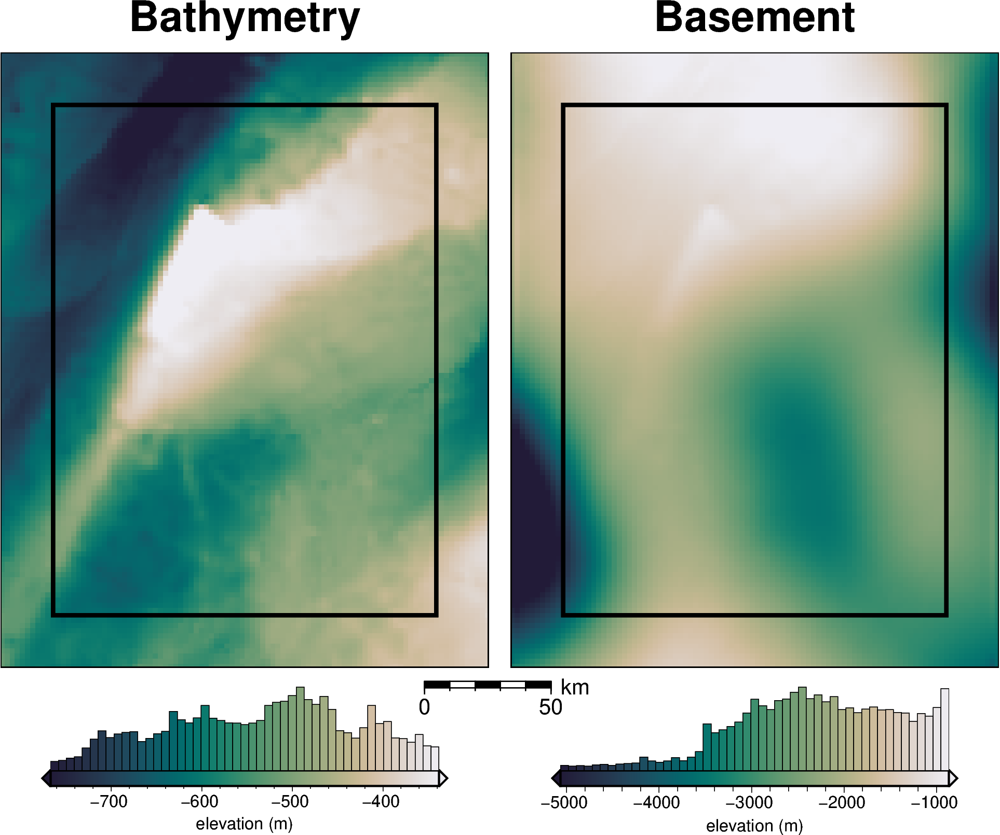

  0%|          | 0/7676 [00:00<?, ?it/s]

  0%|          | 0/7676 [00:00<?, ?it/s]

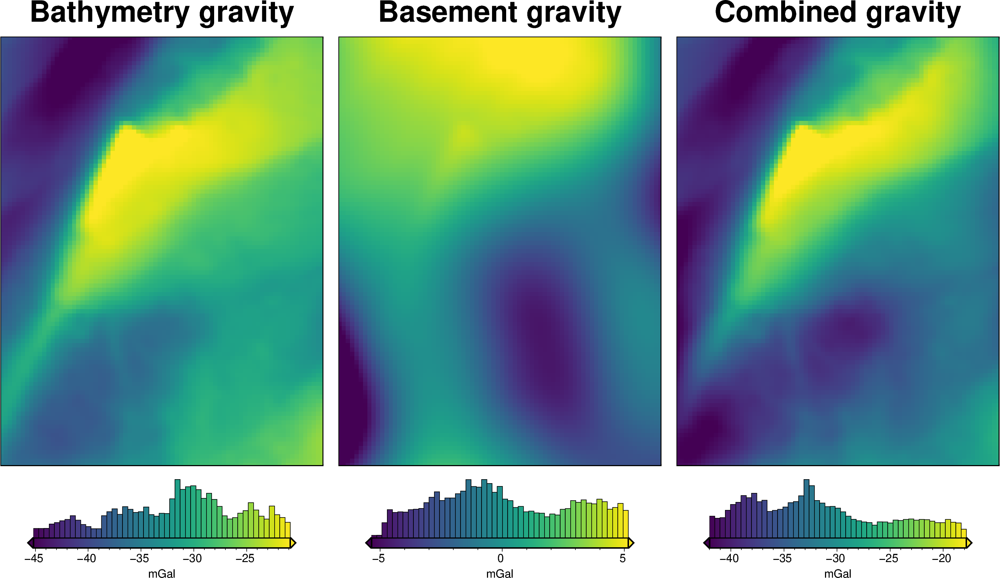

In [3]:
# set grid parameters
spacing = 2e3
inversion_region = (-40e3, 110e3, -1600e3, -1400e3)

true_density_contrast = 1476

bathymetry, basement, grav_df = synthetic.load_synthetic_model(
    spacing=spacing,
    inversion_region=inversion_region,
    buffer=spacing * 10,
    basement=True,
    zref=0,
    bathymetry_density_contrast=true_density_contrast,
)
buffer_region = polar_utils.get_grid_info(bathymetry)[1]

In [4]:
# normalize regional gravity between -1 and 1
grav_df["basement_grav_normalized"] = (
    vd.grid_to_table(
        utils.normalize_xarray(
            grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav,
            low=-1,
            high=1,
        )
    )
    .reset_index()
    .basement_grav
)
grav_df = grav_df.drop(columns=["basement_grav", "disturbance", "gravity_anomaly"])

In [5]:
# re-scale the regional gravity
regional_grav = utils.normalize_xarray(
    grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav_normalized,
    low=0,
    high=15,
).rename("basement_grav")
regional_grav -= regional_grav.mean()

# add to dataframe
grav_df["basement_grav"] = vd.grid_to_table(regional_grav).reset_index().basement_grav

# add basement and bathymetry forward gravities together to make observed gravity
grav_df["gravity_anomaly"] = grav_df.bathymetry_grav + grav_df.basement_grav

new_reg = grav_df.set_index(["northing", "easting"]).to_xarray().basement_grav
new_reg -= new_reg.mean()
print(utils.rmse(new_reg))

3.066626240968995


In [6]:
grav_df

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly
0,-1600000.0,-40000.0,1000.0,-35.551054,-0.575644,-6.050060,-41.601115
1,-1600000.0,-38000.0,1000.0,-36.054657,-0.523222,-5.656896,-41.711553
2,-1600000.0,-36000.0,1000.0,-36.473146,-0.466364,-5.230462,-41.703609
3,-1600000.0,-34000.0,1000.0,-36.755608,-0.406021,-4.777889,-41.533497
4,-1600000.0,-32000.0,1000.0,-36.951029,-0.343163,-4.306449,-41.257478
...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,1.261021,-24.499069
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334797,0.778252,-25.133178
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,0.282827,-25.749987
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-0.219862,-26.341765


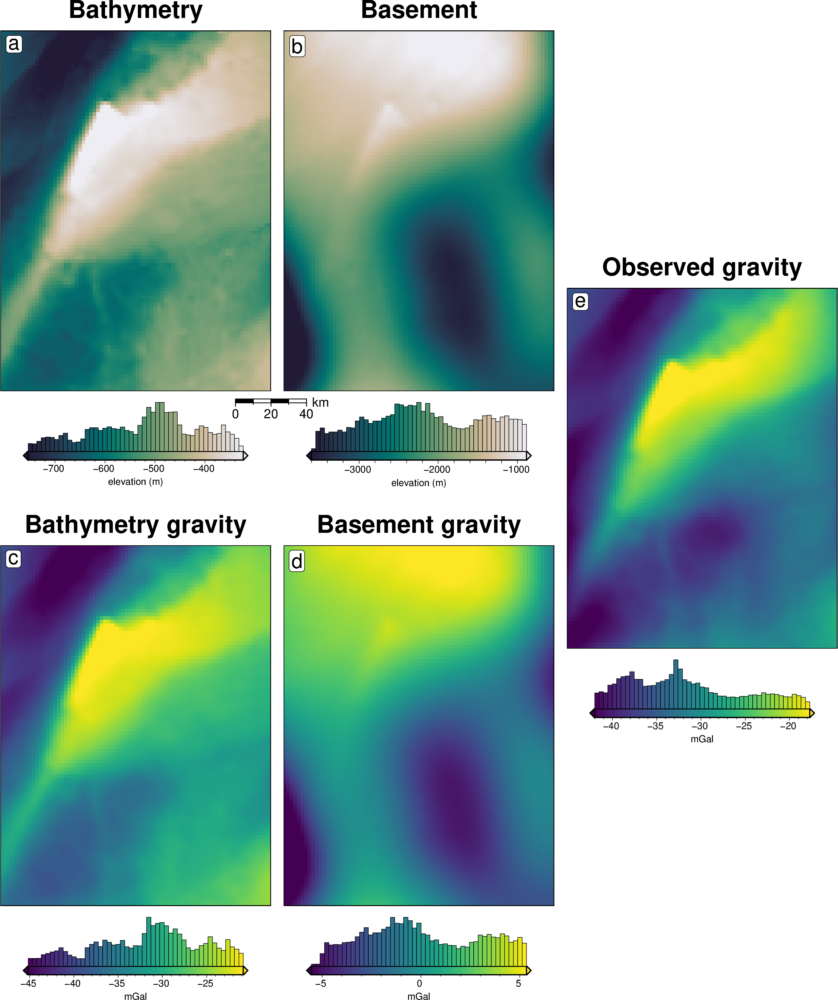

In [7]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    bathymetry,
    region=inversion_region,
    fig_height=10,
    title="Bathymetry",
    hist=True,
    cmap="rain",
    reverse_cpt=True,
    cbar_label="elevation (m)",
    robust=True,
)
fig.text(
    position="TL",
    text="a",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

fig = maps.plot_grd(
    basement,
    region=inversion_region,
    fig_height=10,
    title="Basement",
    hist=True,
    cmap="rain",
    reverse_cpt=True,
    cbar_label="elevation (m)",
    fig=fig,
    origin_shift="xshift",
    robust=True,
    scalebar=True,
    scalebar_position="n-.05/-.035",
)
fig.text(
    position="TL",
    text="b",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

# shift down and 3 to the left
fig = maps.plot_grd(
    grav_grid.bathymetry_grav,
    region=inversion_region,
    fig_height=10,
    title="Bathymetry gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="both",
    xshift_amount=-1,
    yshift_amount=-1,
    robust=True,
)
fig.text(
    position="TL",
    text="c",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig = maps.plot_grd(
    grav_grid.basement_grav,
    region=inversion_region,
    fig_height=10,
    title="Basement gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="xshift",
    robust=True,
)
fig.text(
    position="TL",
    text="d",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)
fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Observed gravity",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="both",
    yshift_amount=0.5,
    robust=True,
)
fig.text(
    position="TL",
    text="e",
    fill="white",
    pen=True,
    font="16p,Helvetica,black",
    offset="j.2/.2",
    clearance="+tO",
    no_clip=True,
)

fig.show()

# Make starting bathymetry model

In [8]:
# semi-regularly spaced
constraint_points = synthetic.constraint_layout_number(
    shape=(6, 7),
    region=inversion_region,
    padding=-spacing,
    shapefile="../results/Ross_Sea_outline.shp",
    add_outside_points=True,
    grid_spacing=spacing,
)

# sample true topography at these points
constraint_points = utils.sample_grids(
    constraint_points,
    bathymetry,
    "true_upward",
    coord_names=("easting", "northing"),
)
constraint_points["upward"] = constraint_points.true_upward
constraint_points.head()

,northing,easting,inside,true_upward,upward
0,-1600000.0,-40000.0,False,-601.093994,-601.093994
1,-1600000.0,-38000.0,False,-609.216919,-609.216919
2,-1600000.0,-36000.0,False,-616.355957,-616.355957
3,-1600000.0,-34000.0,False,-621.262268,-621.262268
4,-1600000.0,-32000.0,False,-625.510925,-625.510925


In [9]:
# grid the sampled values using verde
starting_topography_kwargs = dict(
    method="splines",
    region=buffer_region,
    spacing=spacing,
    constraints_df=constraint_points,
    dampings=None,
)

starting_bathymetry = utils.create_topography(**starting_topography_kwargs)

starting_bathymetry

<xarray.DataArray 'scalars' (northing: 121, easting: 96)> Size: 93kB
array([[-541.24413863, -544.57181181, -547.92293683, ..., -360.00006252,
        -357.06767405, -354.19957764],
       [-543.34402682, -546.81675797, -550.35256327, ..., -362.90253223,
        -359.96874156, -357.11431884],
       [-545.05533616, -548.66036832, -552.37518157, ..., -365.66137903,
        -362.73269529, -359.90052822],
       ...,
       [-591.95335284, -595.51882201, -599.06869706, ..., -440.89315875,
        -440.6944619 , -440.40553782],
       [-590.53134834, -594.09076638, -597.64079289, ..., -440.69158328,
        -440.42525249, -440.07197234],
       [-589.16632672, -592.73504778, -596.3020968 , ..., -440.51760947,
        -440.1713932 , -439.74434037]], shape=(121, 96))
Coordinates:
  * easting   (easting) float64 768B -6e+04 -5.8e+04 ... 1.28e+05 1.3e+05
  * northing  (northing) float64 968B -1.62e+06 -1.618e+06 ... -1.38e+06
Attributes:
    metadata:  Generated by SplineCV(cv=KFold(n_splits=5, random_state=0, shu...
    damping:   None

In [10]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    starting_bathymetry,
    "starting_bathymetry",
    coord_names=("easting", "northing"),
)

constraint_points["dif"] = (
    constraint_points.true_upward - constraint_points.starting_bathymetry
)
rmse = utils.rmse(constraint_points.dif)
print(f"RMSE: {rmse:.2f} m")
constraint_points

RMSE: 0.03 m


,northing,easting,inside,true_upward,upward,starting_bathymetry,dif
0,-1.600000e+06,-4.000000e+04,False,-601.093994,-601.093994,-601.093994,0.000000
1,-1.600000e+06,-3.800000e+04,False,-609.216919,-609.216919,-609.216919,0.000000
2,-1.600000e+06,-3.600000e+04,False,-616.355957,-616.355957,-616.355957,0.000000
3,-1.600000e+06,-3.400000e+04,False,-621.262268,-621.262268,-621.262268,0.000000
4,-1.600000e+06,-3.200000e+04,False,-625.510925,-625.510925,-625.510925,0.000000
...,...,...,...,...,...,...,...
881,-1.418571e+06,-3.637979e-12,True,-747.305711,-747.305711,-747.289192,-0.016520
882,-1.418571e+06,2.333333e+04,True,-619.672055,-619.672055,-619.459742,-0.212313
883,-1.418571e+06,4.666667e+04,True,-505.761536,-505.761536,-505.739808,-0.021728
884,-1.418571e+06,7.000000e+04,True,-447.753091,-447.753091,-447.782831,0.029740


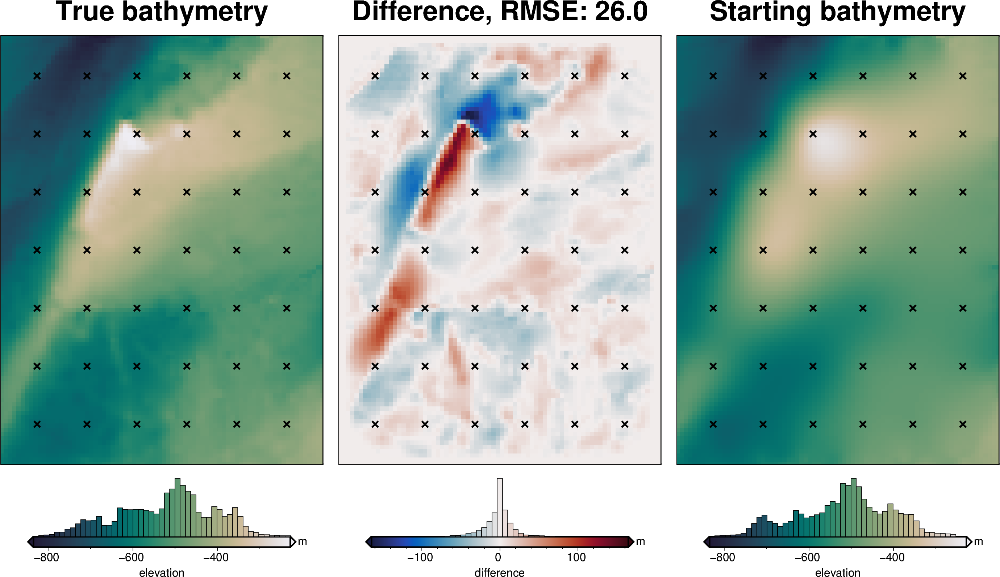

In [11]:
# compare starting and actual bathymetry grids
grids = polar_utils.grd_compare(
    bathymetry,
    starting_bathymetry,
    fig_height=10,
    cmap="rain",
    reverse_cpt=True,
    diff_cmap="balance+h0",
    grid1_name="True bathymetry",
    grid2_name="Starting bathymetry",
    title="Difference",
    title_font="18p,Helvetica-Bold,black",
    cbar_unit="m",
    cbar_label="elevation",
    RMSE_decimals=0,
    region=inversion_region,
    inset=False,
    hist=True,
    label_font="16p,Helvetica,black",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [12]:
# the true density contrast is 1476 kg/m3
density_contrast = 1350

# set the reference level from the prisms to 0
zref = 0

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)

# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)

grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df

  0%|          | 0/7676 [00:00<?, ?it/s]

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity
0,-1600000.0,-40000.0,1000.0,-35.551054,-0.575644,-6.050060,-41.601115,-32.541367
1,-1600000.0,-38000.0,1000.0,-36.054657,-0.523222,-5.656896,-41.711553,-32.965831
2,-1600000.0,-36000.0,1000.0,-36.473146,-0.466364,-5.230462,-41.703609,-33.347648
3,-1600000.0,-34000.0,1000.0,-36.755608,-0.406021,-4.777889,-41.533497,-33.644496
4,-1600000.0,-32000.0,1000.0,-36.951029,-0.343163,-4.306449,-41.257478,-33.840063
...,...,...,...,...,...,...,...,...
7671,-1400000.0,102000.0,1000.0,-25.760090,0.399167,1.261021,-24.499069,-23.321506
7672,-1400000.0,104000.0,1000.0,-25.911429,0.334797,0.778252,-25.133178,-23.482116
7673,-1400000.0,106000.0,1000.0,-26.032814,0.268741,0.282827,-25.749987,-23.605602
7674,-1400000.0,108000.0,1000.0,-26.121903,0.201716,-0.219862,-26.341765,-23.693171


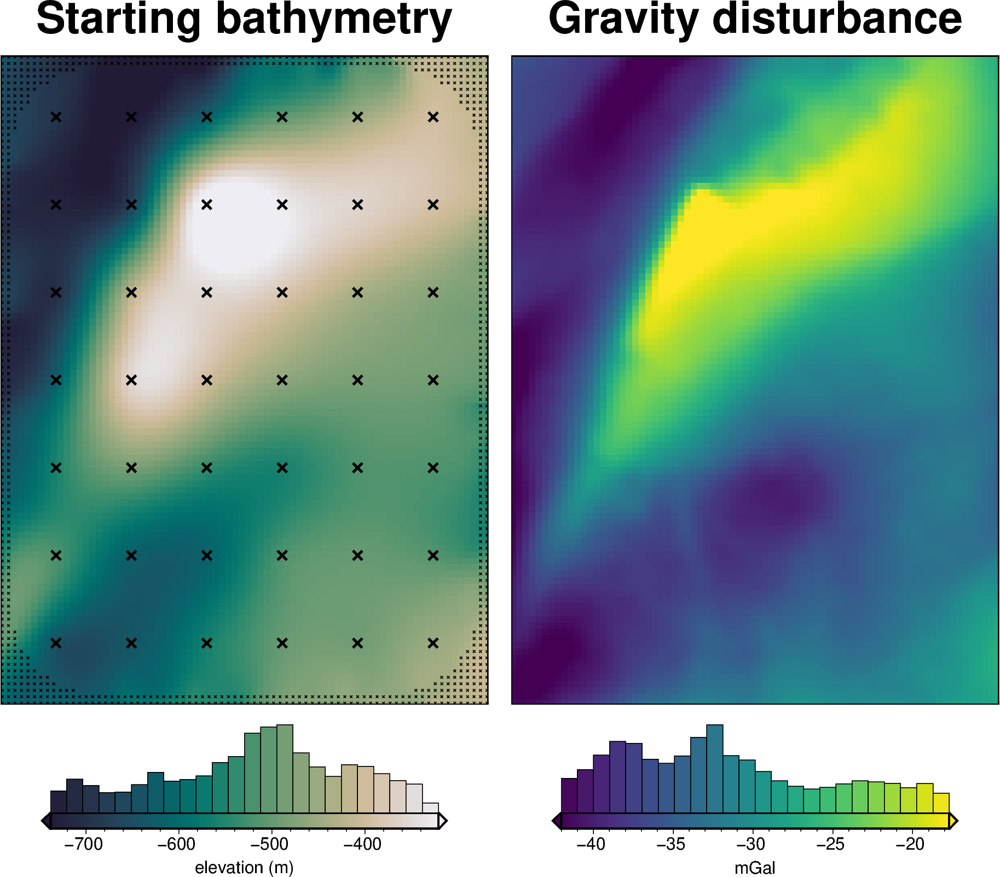

In [62]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    starting_bathymetry,
    region=inversion_region,
    fig_height=10,
    title="Starting bathymetry",
    hist=True,
    cmap="rain",
    reverse_cpt=True,
    cbar_label="elevation (m)",
    robust=True,
    hist_bin_num=25,
)

fig.plot(
    x=constraint_points.easting,
    y=constraint_points.northing,
    style="x.05c",
)
fig.plot(
    x=constraint_points[constraint_points.inside].easting,
    y=constraint_points[constraint_points.inside].northing,
    style="x.2c",
    pen="1p,black",
)

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Gravity disturbance",
    hist=True,
    cbar_label="mGal",
    fig=fig,
    origin_shift="x",
    robust=True,
    hist_bin_num=25,
)

fig.show()

# Regional misfit

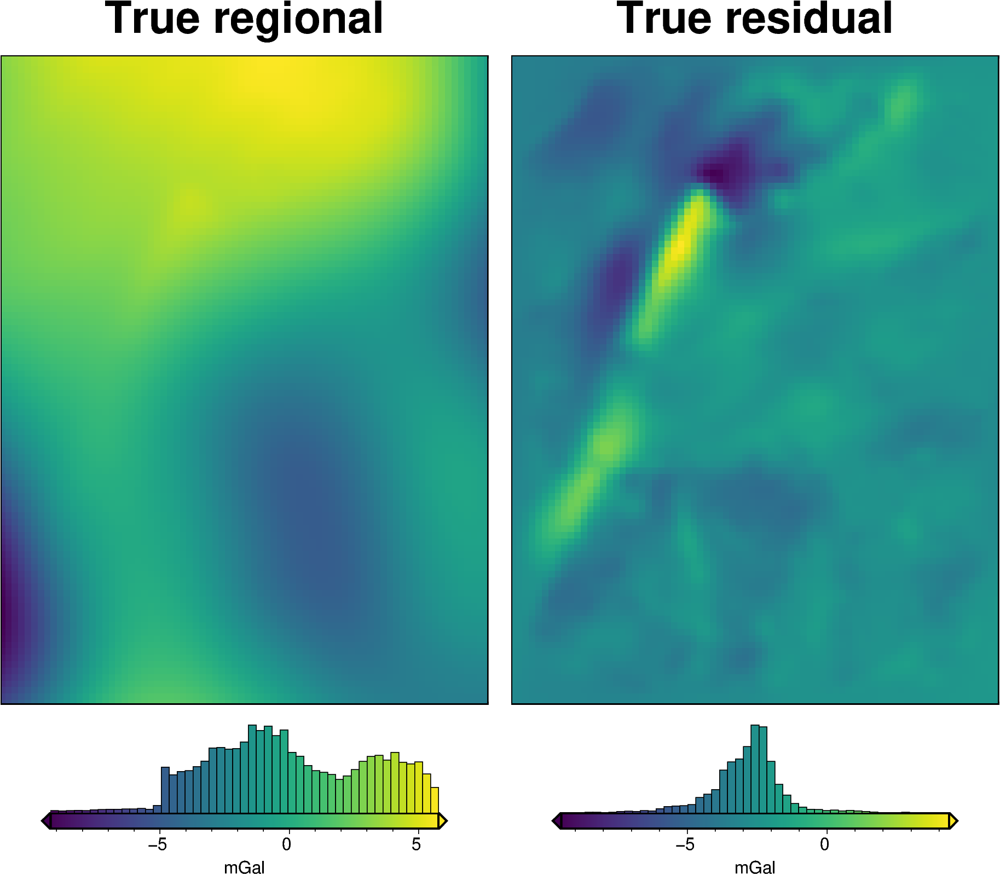

In [13]:
# calculate the true residual misfit
grav_df["true_res"] = grav_df.bathymetry_grav - grav_df.starting_gravity

# grid the results
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.basement_grav,
    fig_height=10,
    title="True regional",
    hist=True,
    cbar_label="mGal",
)

fig = maps.plot_grd(
    grav_grid.true_res,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="True residual",
    hist=True,
    cbar_label="mGal",
)

fig.show()

In [14]:
def regional_comparison(df):
    # grid the results
    grav_grid = df.set_index(["northing", "easting"]).to_xarray()

    # calculate the true residual and regional misfit
    grav_grid["true_res"] = grav_grid.bathymetry_grav - grav_grid.starting_gravity
    # grav_grid["true_reg"] = grav_grid.gravity_anomaly - grav_grid.bathymetry_grav
    grav_grid["true_reg"] = grav_grid.basement_grav

    # compare with true regional
    _ = polar_utils.grd_compare(
        grav_grid.true_reg-(grav_grid.true_reg.mean()-grav_grid.reg.mean()),
        grav_grid.reg,
        grid1_name="True regional misfit",
        grid2_name="Regional misfit",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )
    # compare with true residual
    _ = polar_utils.grd_compare(
        grav_grid.true_res-(grav_grid.true_res.mean()-grav_grid.res.mean()),
        grav_grid.res,
        grid1_name="True residual misfit",
        grid2_name="Residual misfit",
        cmap="balance+h0",
        hist=True,
        inset=False,
        verbose="q",
        title="difference",
        grounding_line=False,
        points=constraint_points,
        points_style="x.3c",
    )

In [15]:
# estimate regional with the mean misfit at constraints
regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    cv=True,
    cv_kwargs=dict(
        n_trials=10,
        depth_limits=(100, 400e3),
        progressbar=False,
        fname="../tmp_outputs/inversion_for_poster_regional_sep",
    ),
    block_size=None,
    damping=None,
)

INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 8
INFO:invert4geom:	parameter: {'depth': 215980.51982333654}
INFO:invert4geom:	scores: [0.9985923182563561]


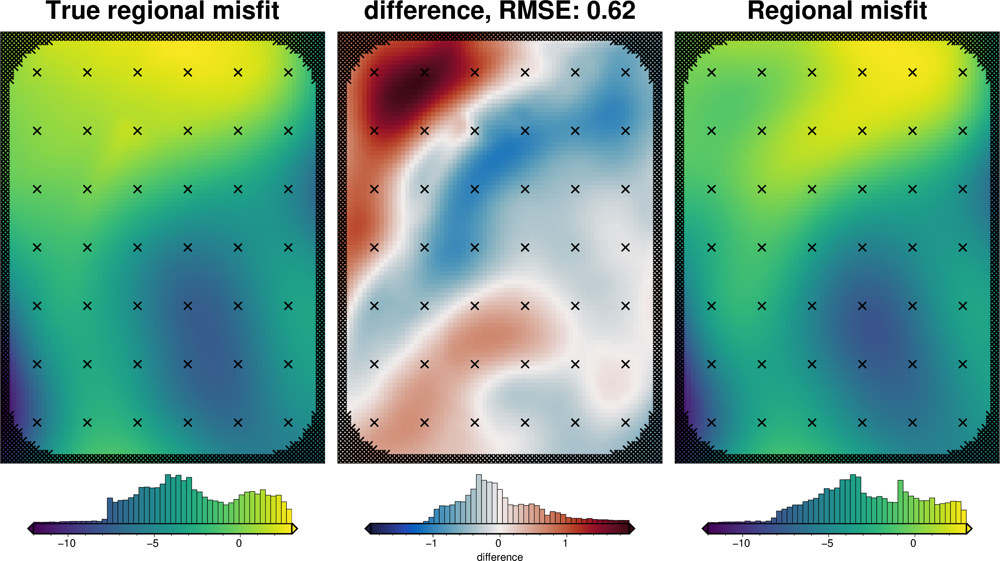

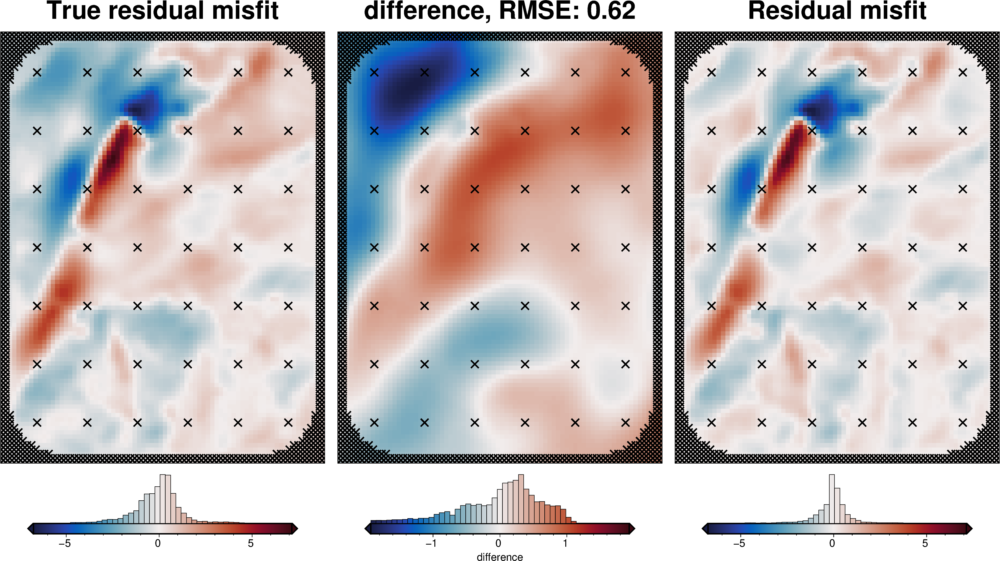

,northing,easting,upward,bathymetry_grav,basement_grav_normalized,basement_grav,gravity_anomaly,starting_gravity,true_res,misfit,reg,res
count,7.676000e+03,7676.000000,7676.0,7676.000000,7676.000000,7.676000e+03,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000,7676.000000
mean,-1.500000e+06,35000.000000,1000.0,-31.727281,0.231031,2.132739e-15,-31.727281,-28.869499,-2.857783,-2.857783,-2.778073,-0.079710
std,5.831332e+04,43877.680138,0.0,6.458148,0.408910,3.066826e+00,6.785725,5.735684,1.373353,3.126043,2.991480,1.179434
min,-1.600000e+06,-40000.000000,1000.0,-48.457772,-1.000000,-9.232729e+00,-43.436091,-44.455618,-9.507972,-11.980054,-11.956097,-6.760082
25%,-1.550000e+06,-2500.000000,1000.0,-36.286366,-0.073818,-2.286364e+00,-37.325083,-32.676771,-3.516046,-4.970609,-4.918485,-0.403693
50%,-1.500000e+06,35000.000000,1000.0,-31.030069,0.181838,-3.689471e-01,-32.776247,-28.426806,-2.725032,-3.238330,-3.135825,-0.005419
75%,-1.450000e+06,72500.000000,1000.0,-27.278975,0.596585,2.741659e+00,-27.106499,-24.769776,-2.210131,-0.694202,-0.433396,0.302434
max,-1.400000e+06,110000.000000,1000.0,-16.585798,1.000000,5.767271e+00,-12.362401,-15.540467,4.358587,8.136974,2.844888,6.896523


In [16]:
temp_reg_kwargs = copy.deepcopy(regional_grav_kwargs)

# temporarily set some kwargs
temp_reg_kwargs["cv_kwargs"]["plot"] = True
temp_reg_kwargs["cv_kwargs"]["progressbar"] = True

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **temp_reg_kwargs,
)

regional_comparison(grav_df)
grav_df.describe()

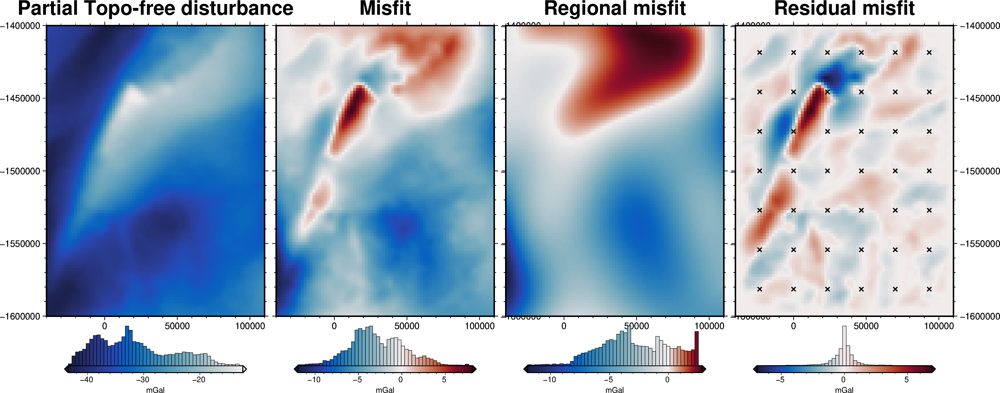

In [17]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

In [16]:
# set kwargs to pass to the inversion
kwargs = {
    # set stopping criteria
    "max_iterations": 200,
    "l2_norm_tolerance": 0.2**0.5,  # square root of the gravity noise
    "delta_l2_norm_tolerance": 1.008,
}

# Damping Cross Validation

In [19]:
logging.getLogger().setLevel(logging.INFO)

# run the inversion workflow, including a cross validation for the damping parameter
results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    starting_prisms=starting_prisms,
    # for creating test/train splits
    grav_spacing=spacing,
    inversion_region=inversion_region,
    run_damping_cv=True,
    damping_limits=(0.001, 0.1),
    damping_cv_trials=8,
    fname=f"{fpath}_damping_cv",
    **kwargs,
)

INFO:invert4geom:saving all results with root name '../results/Ross_Sea/inversion_for_poster_damping_cv'
INFO:invert4geom:running damping cross validation
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 7
INFO:invert4geom:	parameter: {'damping': 0.013317391250485854}
INFO:invert4geom:	scores: [0.013293151074224392]
INFO:invert4geom:results saved to ../results/Ross_Sea/inversion_for_poster_damping_cv_results.pickle.pickle


In [17]:
# load saved inversion results
with pathlib.Path(f"{fpath}_damping_cv_results.pickle").open(
    "rb"
) as f:
    results = pickle.load(f)

# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

In [18]:
best_damping = parameters.get("Solver damping")
kwargs["solver_damping"] = best_damping
best_damping

0.013317391250485854

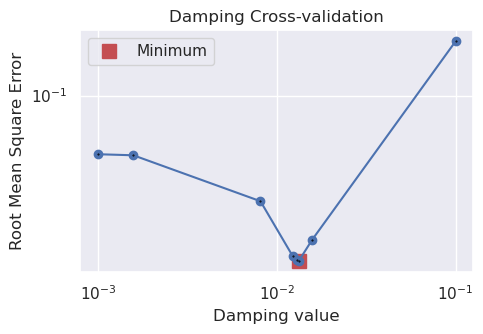

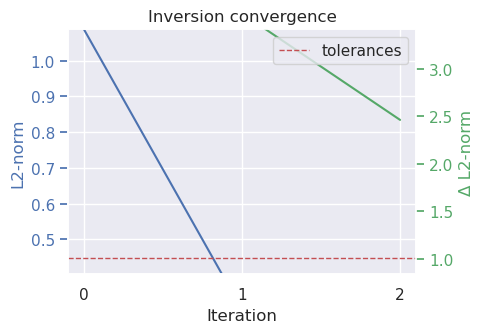

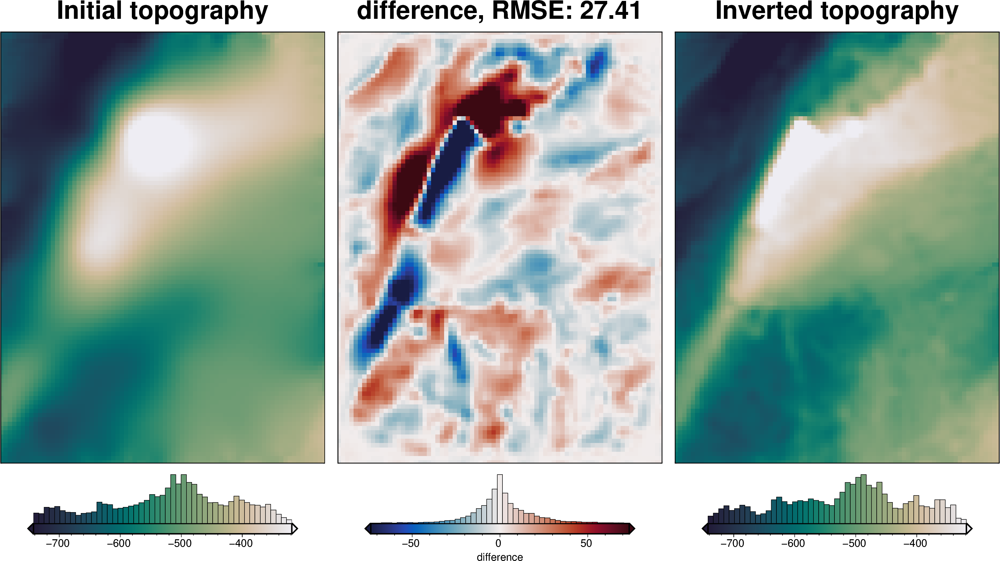

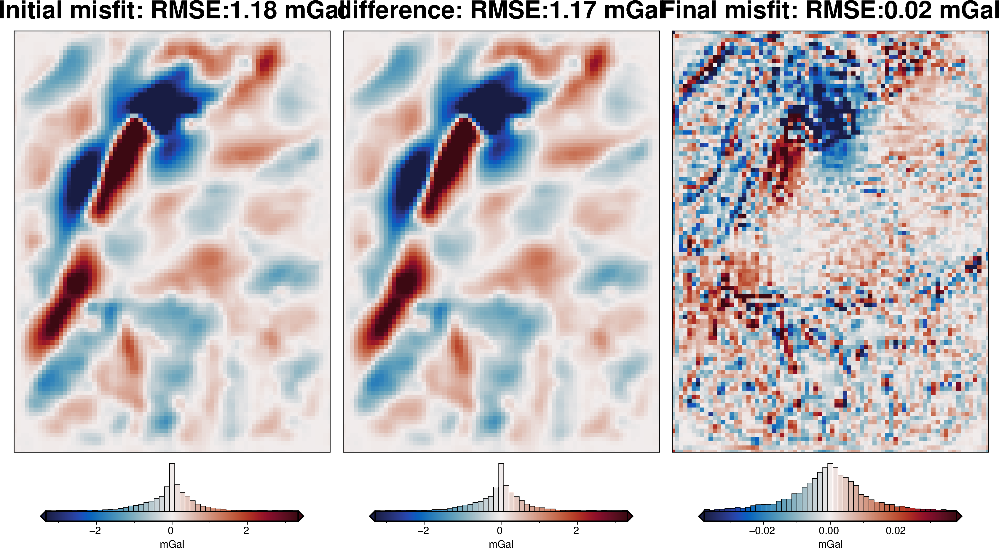

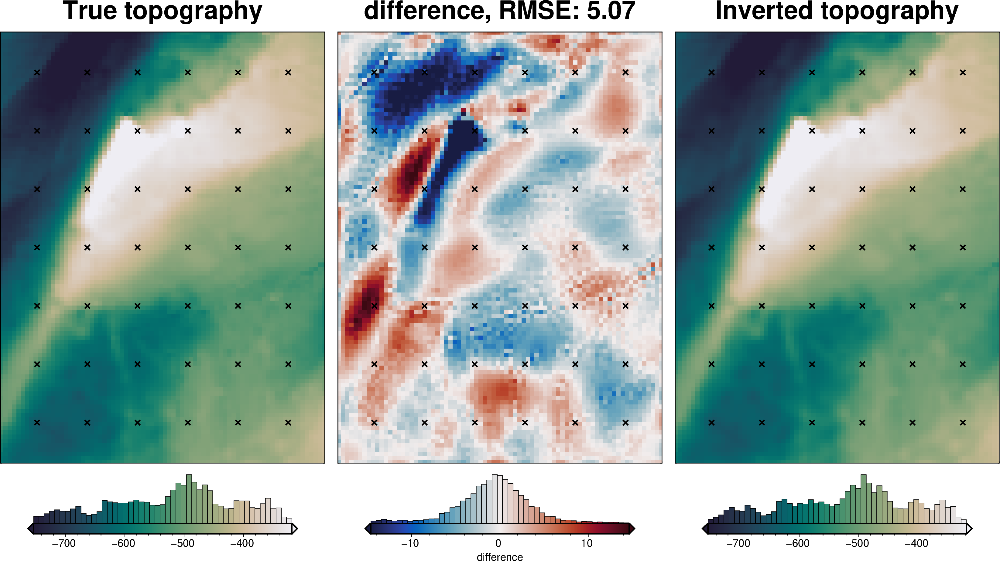

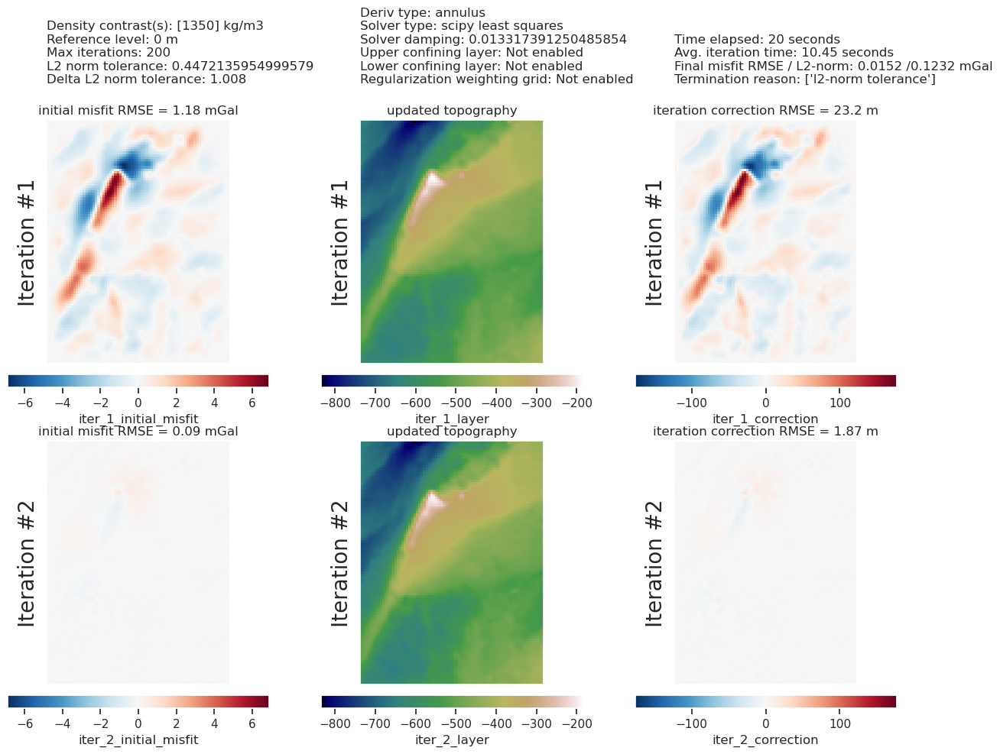

In [19]:
study_df = study.trials_dataframe()

plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)

plotting.plot_convergence(
    grav_results,
    params=parameters,
)

plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [20]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 2.54 m


# Density CV

INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 7
INFO:invert4geom:	parameter: {'density_contrast': 1513}
INFO:invert4geom:	scores: [78.82675890351236]


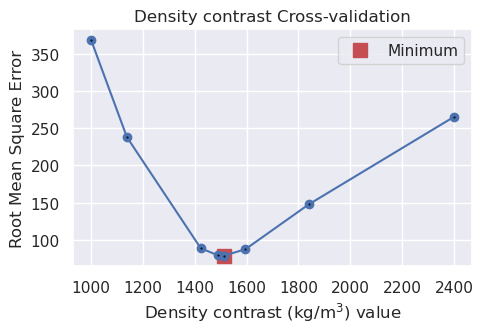

In [23]:
# run the cross validation for density
study, inversion_results = optimization.optimize_inversion_zref_density_contrast(
    grav_df=grav_df,
    constraints_df=constraint_points,
    density_contrast_limits=(1000, 2400),
    zref=0,
    n_trials=8,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=dict(
        method="constant",
        constant=0,
    ),
    fname=f"{fpath}_density_cv",
    **kwargs,
)

In [ ]:
# # run a 5-fold cross validation for 10 parameter sets of density
# # this performs 50 regional separations and 50 inversions
# study, inversion_results = optimization.optimize_inversion_zref_density_contrast_kfolds(
#     grav_df=grav_df,
#     constraints_df=constraint_points[constraint_points.inside],
#     density_contrast_limits=(1000, 2400),
#     zref=0,
#     n_trials=12,
#     split_kwargs=dict(
#         n_splits=4,
#         method="KFold",
#     ),
#     seed=2,
#     regional_grav_kwargs=regional_grav_kwargs,
#     starting_topography_kwargs=starting_topography_kwargs,
#     fname=f"{fpath}_density_cv_kfolds",
#     fold_progressbar=False,
#     **kwargs,
# )

In [21]:
# load study from normal optimization
with pathlib.Path(f"{fpath}_density_cv_study.pickle").open("rb") as f:
    study = pickle.load(f)
    optimized_density = study.best_params["density_contrast"]

# # load study from kfold optimization
# with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open(
#     "rb"
# ) as f:
#     study = pickle.load(f)
#     kfold_optimized_density = study.best_params["density_contrast"]

print("optimal density contrast from normal optimization: ", optimized_density)
# print("optimal density contrast from K-folds optimization: ", kfold_optimized_density)
print("real density contrast", true_density_contrast)

best_density_contrast = optimized_density
# best_density_contrast = min(
#     [optimized_density, kfold_optimized_density],
#     key=lambda x: abs(x - true_density_contrast),
# )

optimal density contrast from normal optimization:  1513
real density contrast 1476


In [22]:
print("optimal determined density contrast", best_density_contrast)
print("real density contrast", true_density_contrast)
print("density error", best_density_contrast - true_density_contrast)

optimal determined density contrast 1513
real density contrast 1476
density error 37


### Redo with optimal density contrast
During the density cross-validation to avoid biasing the scores, we had to manually set a regional field. Now, with the optimal density contrast value found, we can rerun the inversion with an automatically determined regional field strength (the average value misfit at the constraints).

  0%|          | 0/7676 [00:00<?, ?it/s]

INFO:invert4geom:using 4 startup trials
INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 4
INFO:invert4geom:	parameter: {'depth': 312531.93345987285}
INFO:invert4geom:	scores: [0.9992923120247144]


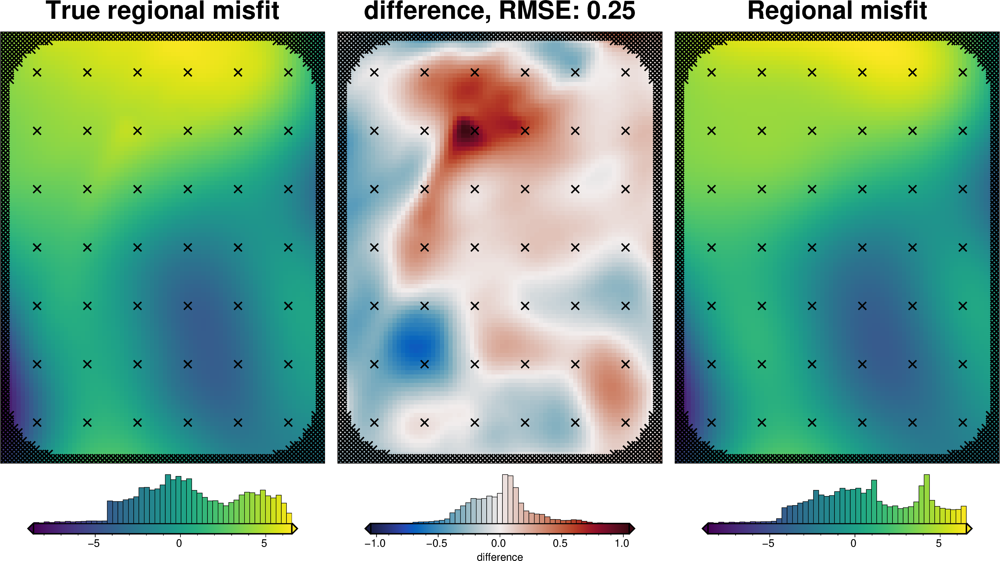

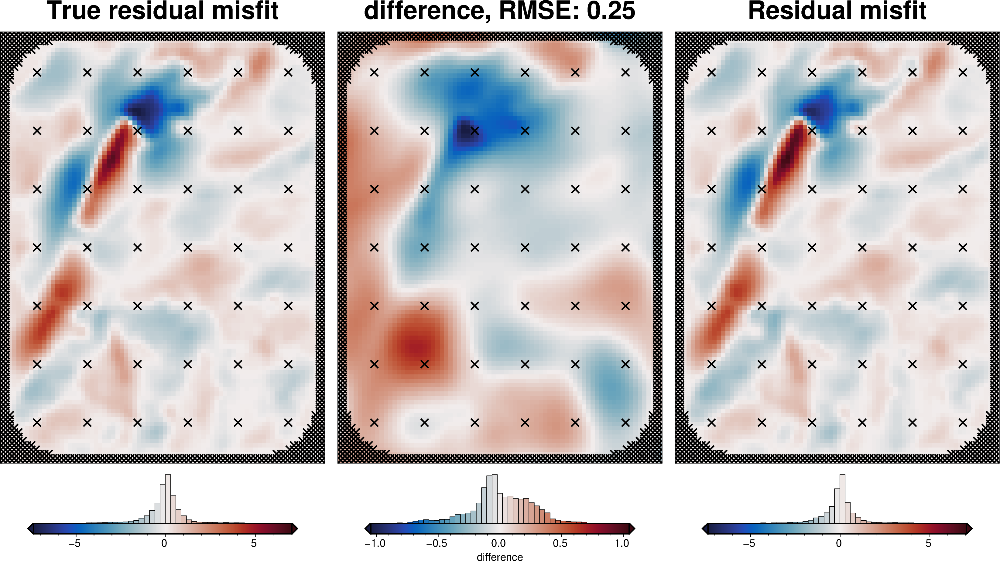

In [23]:
density_contrast = best_density_contrast

density_grid = xr.where(
    starting_bathymetry >= zref,
    density_contrast,
    -density_contrast,
)
# create layer of prisms
starting_prisms = utils.grids_to_prisms(
    starting_bathymetry,
    zref,
    density=density_grid,
)
grav_df["starting_gravity"] = starting_prisms.prism_layer.gravity(
    coordinates=(
        grav_df.easting,
        grav_df.northing,
        grav_df.upward,
    ),
    field="g_z",
    progressbar=True,
)

grav_df = regional.regional_separation(
    grav_df=grav_df,
    **regional_grav_kwargs,
)

regional_comparison(grav_df)

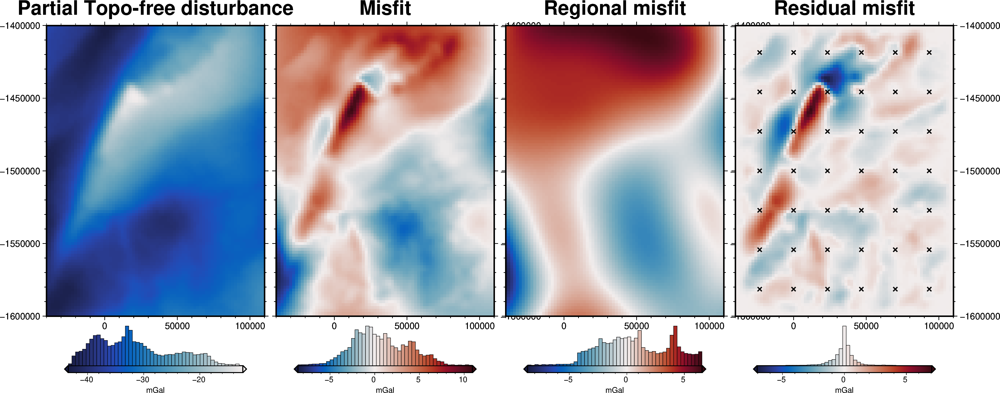

In [54]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()

fig = maps.plot_grd(
    grav_grid.gravity_anomaly,
    region=inversion_region,
    fig_height=10,
    title="Partial Topo-free disturbance",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSWe", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="xshift",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    frame=["nSwE", "xaf10000", "yaf10000"],
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)
fig.show()

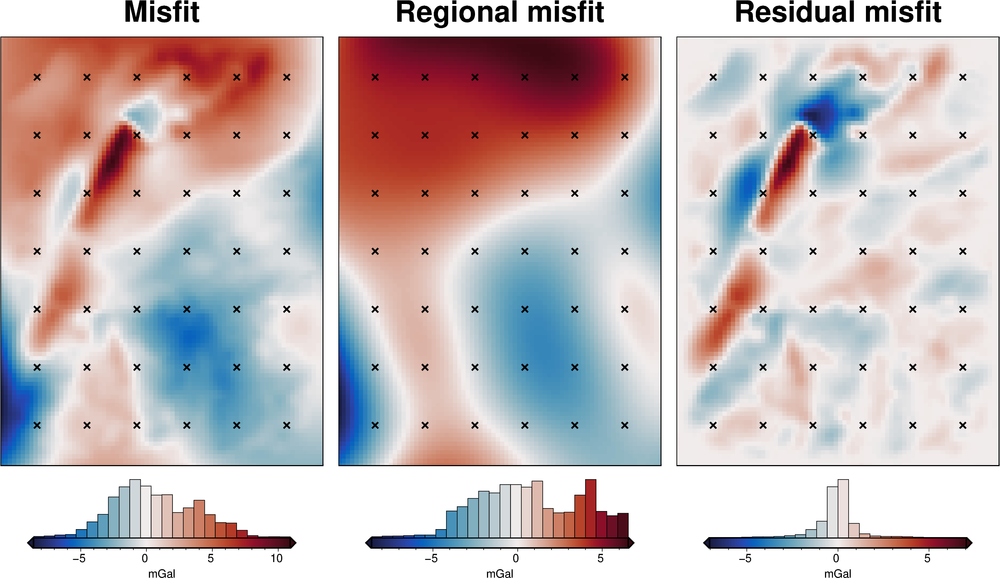

In [60]:
grav_grid = grav_df.set_index(["northing", "easting"]).to_xarray()


fig = maps.plot_grd(
    grav_grid.misfit,
    region=inversion_region,
    fig_height=10,
    title="Misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    hist_bin_num=25,
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

fig = maps.plot_grd(
    grav_grid.reg,
    region=inversion_region,
    fig=fig,
    origin_shift="x",
    fig_height=10,
    title="Regional misfit",
    cmap="balance+h0",
    hist=True,
    cbar_label="mGal",
    hist_bin_num=25,
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

fig = maps.plot_grd(
    grav_grid.res,
    region=inversion_region,
    fig=fig,
    origin_shift="x",
    fig_height=10,
    title="Residual misfit",
    cmap="balance+h0",
    cpt_lims=[-vd.maxabs(grav_grid.res), vd.maxabs(grav_grid.res)],
    hist=True,
    cbar_label="mGal",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
    hist_bin_num=25,
)
fig.show()

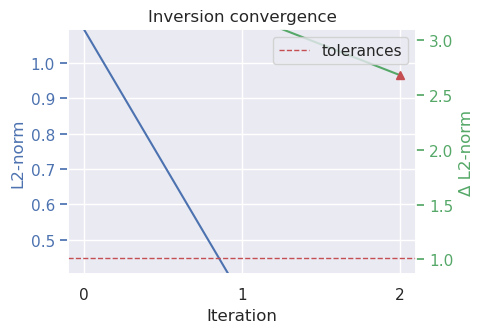

In [29]:
# run the inversion workflow
inversion_results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    fname=f"{fpath}_optimal",
    starting_prisms=starting_prisms,
    plot_dynamic_convergence=True,
    **kwargs,
)

In [25]:
# load saved inversion results
with pathlib.Path(f"{fpath}_optimal_results.pickle").open("rb") as f:
    results = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

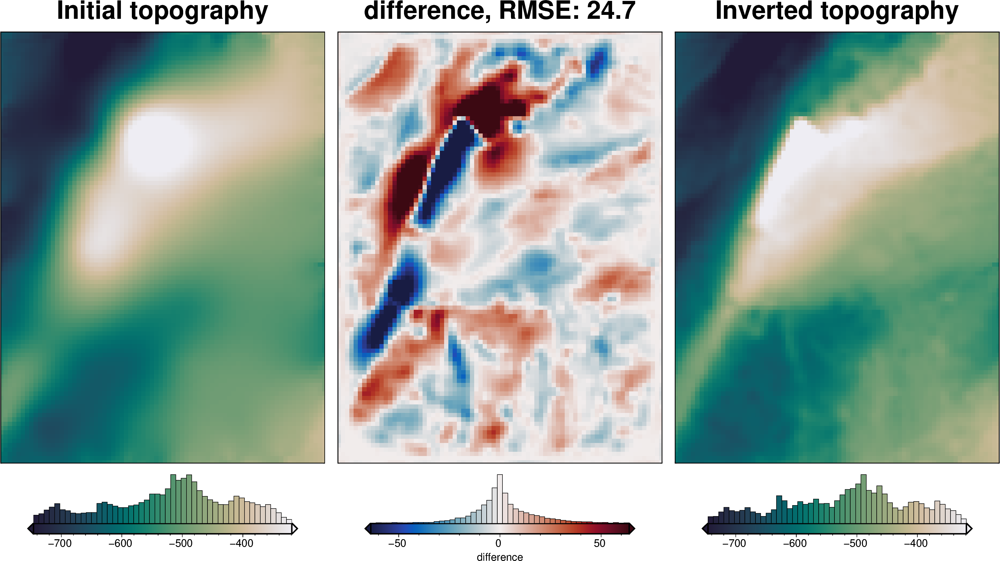

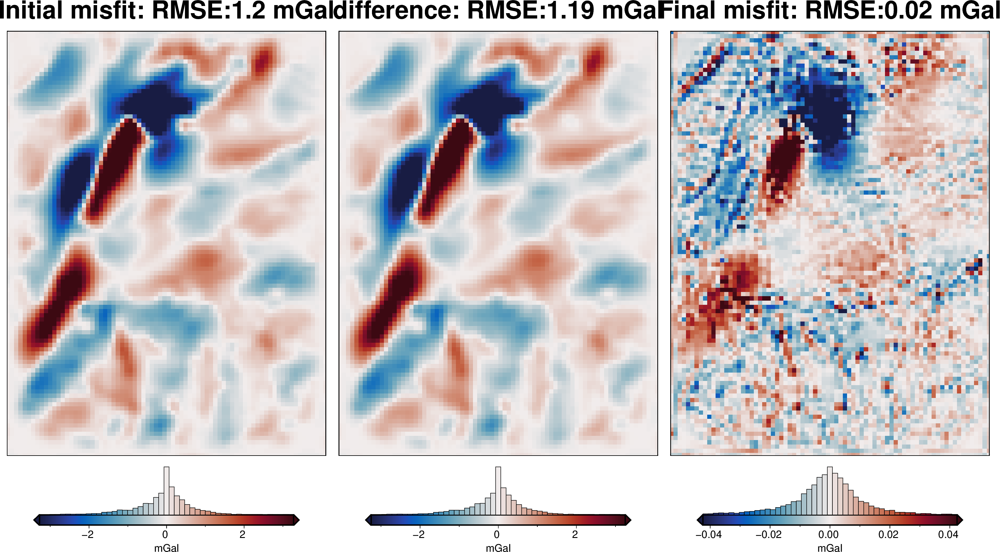

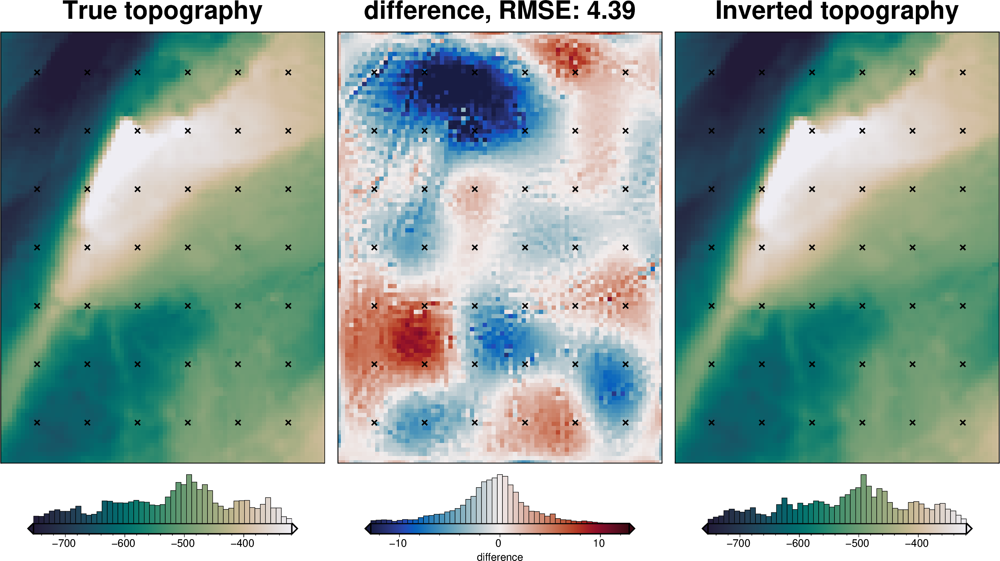

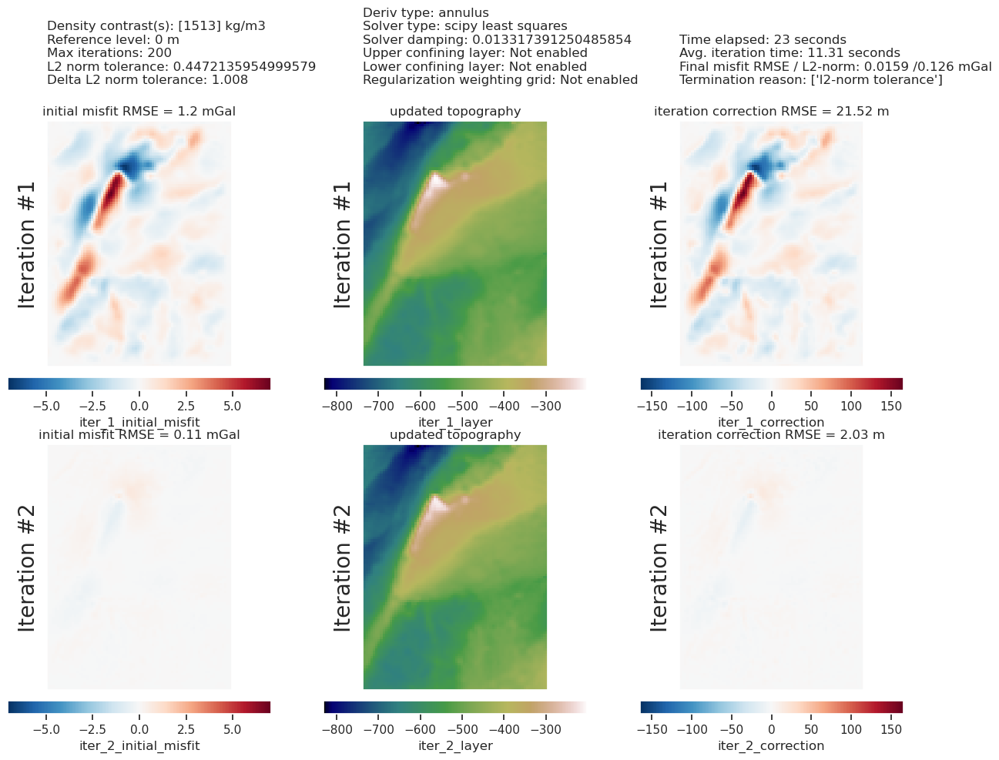

In [26]:
plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [27]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 2.18 m


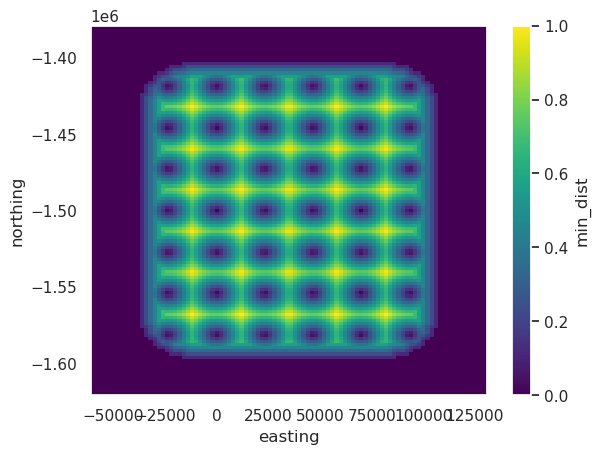

In [29]:
# calculate the distance between each grid cell and the nearest constraint, then
# normalize those values between 0 and 1
weighting_grid = utils.normalized_mindist(
    constraint_points,
    starting_prisms,
    low=0,
    high=1,
    region=inversion_region,
)
weighting_grid.plot()

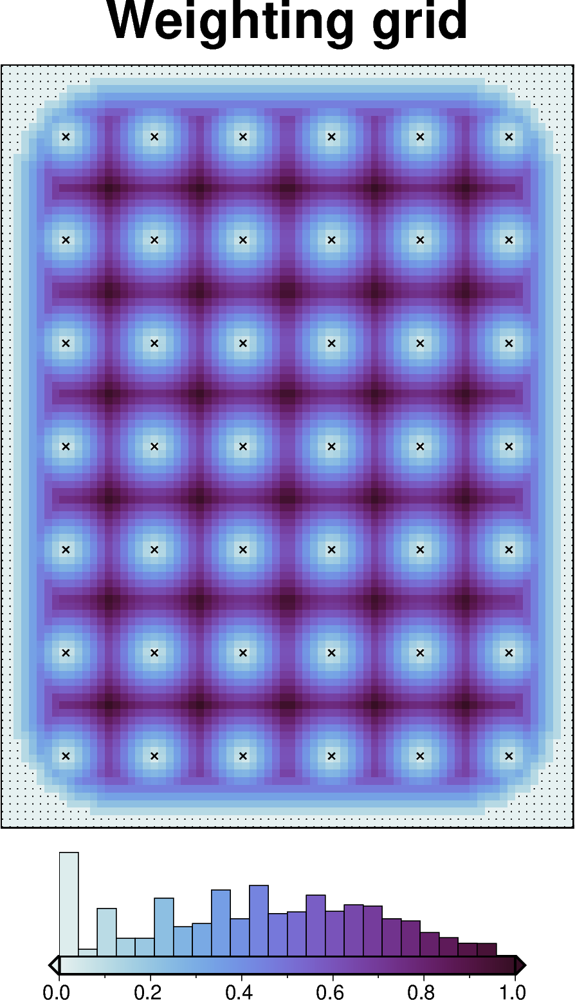

In [ ]:
# weighting_grid = polar_utils.mask_from_shp(
#     gpd.read_file("../plotting/RIS_outline.shp").buffer(-5e3),
#     # "../plotting/RIS_outline.shp",
#     xr_grid=weighting_grid,
#     masked=True,
#     invert=False,
# )
fig = maps.plot_grd(
    weighting_grid,
    region=inversion_region,
    fig_height=10,
    title="Weighting grid",
    cmap="dense",
    hist=True,
    hist_bin_num=25,
)

fig.plot(
    x=constraint_points[constraint_points.inside].easting,
    y=constraint_points[constraint_points.inside].northing,
    style="x0.12c",
    pen=".5p",
)
fig.plot(
    x=constraint_points[constraint_points.inside == False].easting,
    y=constraint_points[constraint_points.inside == False].northing,
    style="p",
)

fig.show()

In [38]:
logging.getLogger().setLevel(logging.INFO)

# run the inversion workflow, including a cross validation for the damping parameter
results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    starting_prisms=starting_prisms,
    # for creating test/train splits
    grav_spacing=spacing,
    inversion_region=inversion_region,
    run_damping_cv=True,
    damping_limits=(0.00001, 0.01),
    damping_cv_trials=6,
    fname=f"{fpath}_damping_cv_weighted",
    apply_weighting_grid=True,
    weighting_grid=weighting_grid,
    **kwargs,
)

INFO:invert4geom:saving all results with root name '../results/Ross_Sea/inversion_for_poster_damping_cv_weighted'
INFO:invert4geom:running damping cross validation
INFO:invert4geom:using 4 startup trials


  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

INFO:invert4geom:Trial with best score: 
INFO:invert4geom:	trial number: 0
INFO:invert4geom:	parameter: {'damping': 1e-05}
INFO:invert4geom:	scores: [0.13234138593412595]
INFO:invert4geom:results saved to ../results/Ross_Sea/inversion_for_poster_damping_cv_weighted_results.pickle.pickle


In [39]:
# load saved inversion results
with pathlib.Path(f"{fpath}_damping_cv_weighted_results.pickle").open(
    "rb"
) as f:
    results = pickle.load(f)

# load study
with pathlib.Path(f"{fpath}_damping_cv_weighted_damping_cv_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

In [40]:
best_damping = parameters.get("Solver damping")
kwargs["solver_damping"] = best_damping
best_damping

1e-05

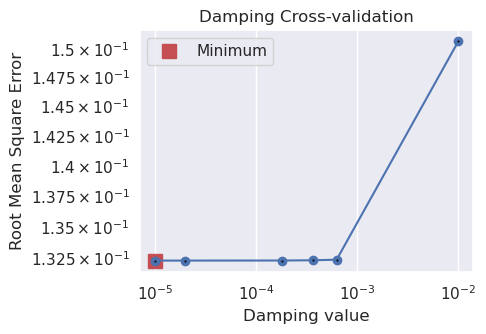

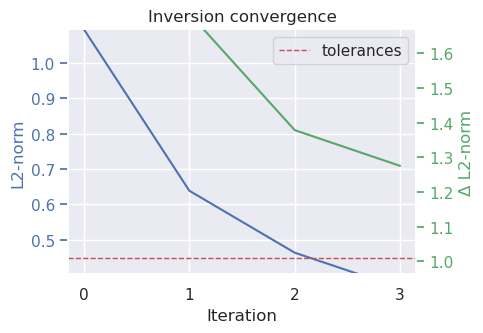

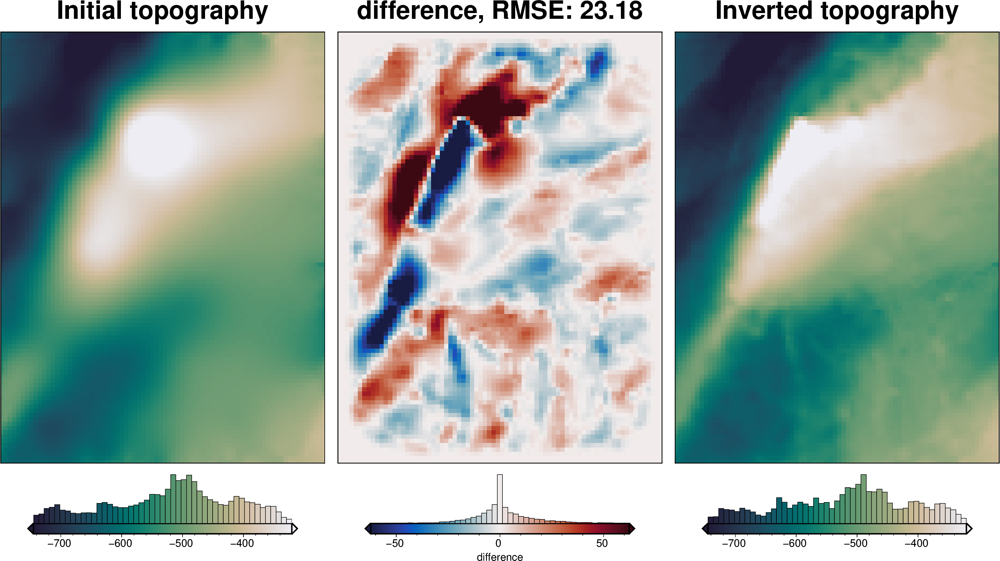

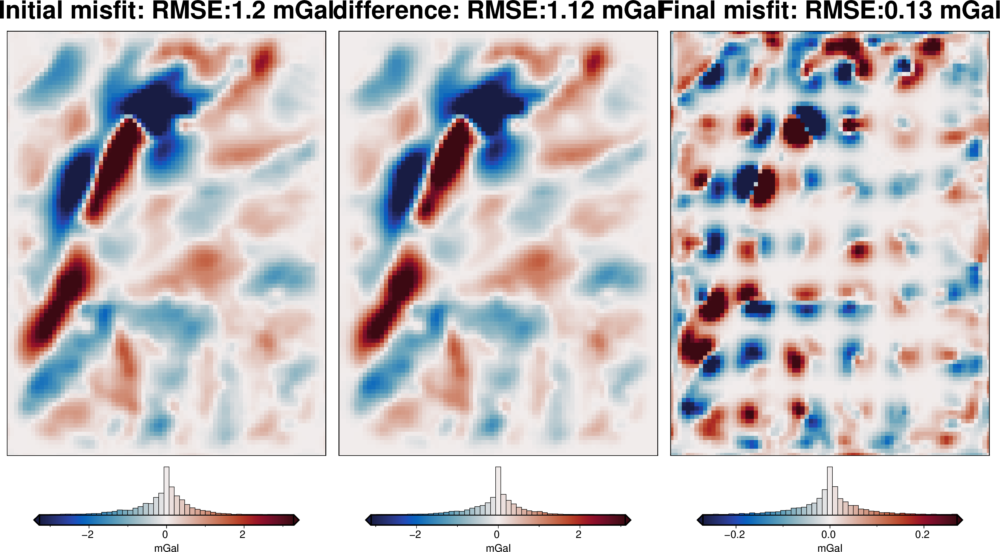

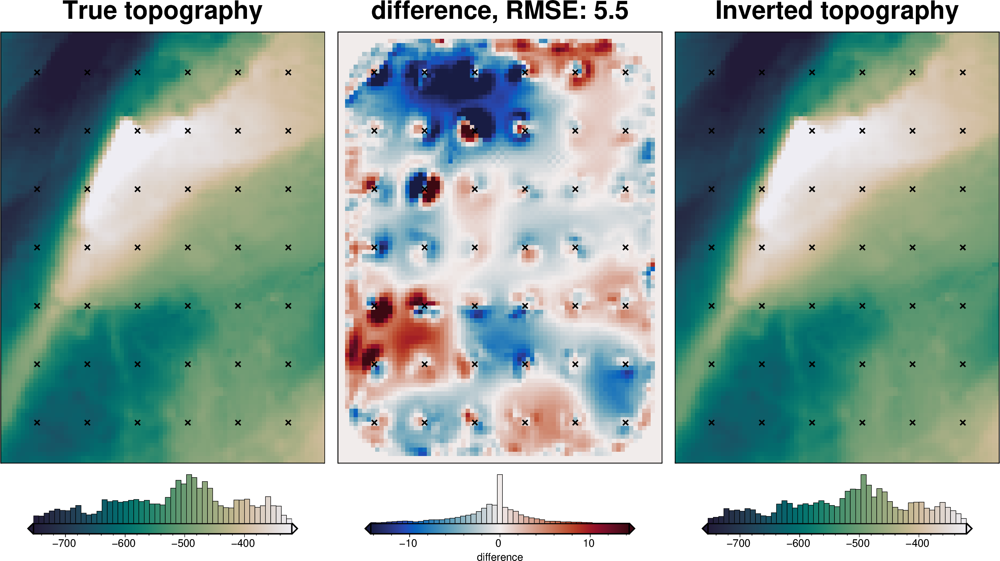

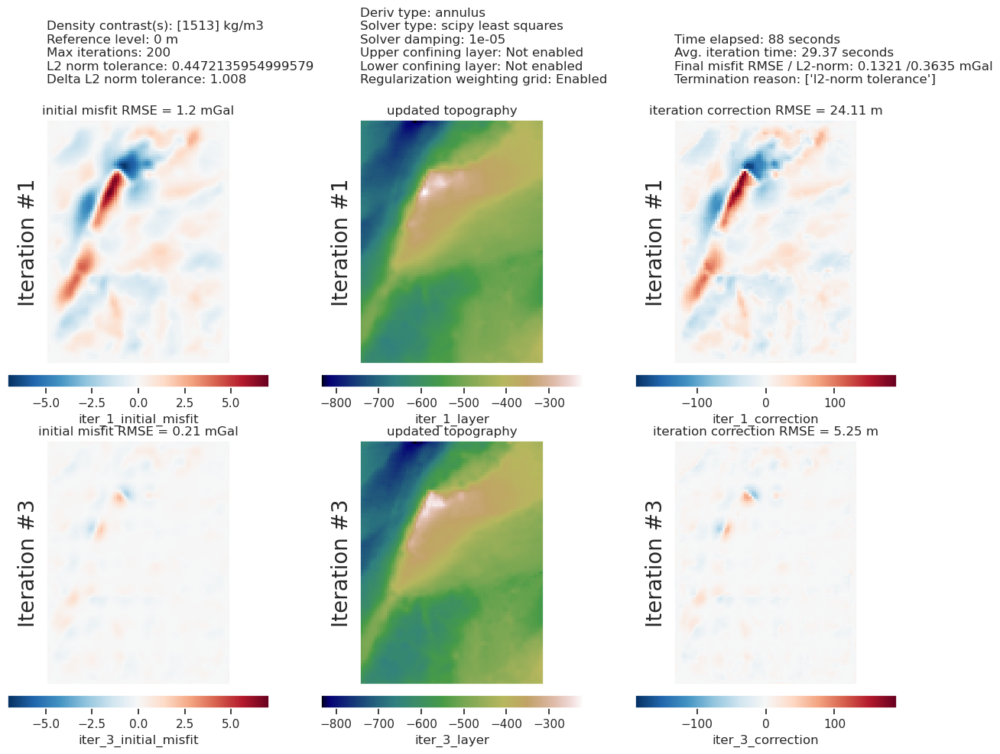

In [41]:
study_df = study.trials_dataframe()

plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)

plotting.plot_convergence(
    grav_results,
    params=parameters,
)

plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [42]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.17 m


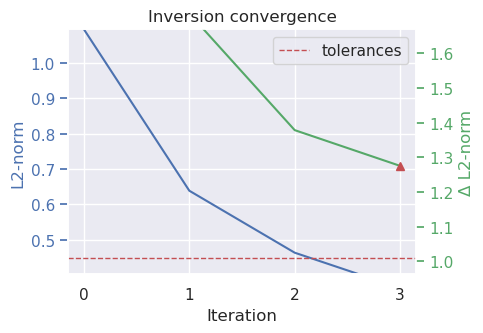

In [43]:
# run the inversion workflow with weighting
new_kwargs = copy.deepcopy(kwargs)
new_kwargs['solver_damping'] = None
inversion_results = inversion.run_inversion_workflow(
    grav_df=grav_df,
    fname=f"{fpath}_optimal_weighted",
    starting_prisms=starting_prisms,
    plot_dynamic_convergence=True,
    apply_weighting_grid=True,
    weighting_grid=weighting_grid,
    **new_kwargs,
)

In [44]:
# load saved inversion results
with pathlib.Path(f"{fpath}_optimal_weighted_results.pickle").open("rb") as f:
    results = pickle.load(f)

# collect the results
topo_results, grav_results, parameters, elapsed_time = results

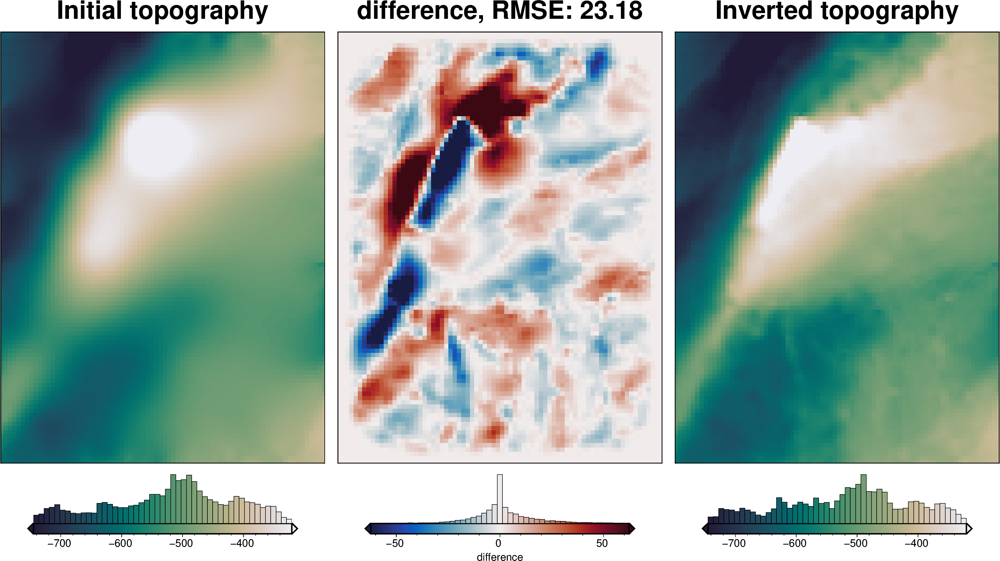

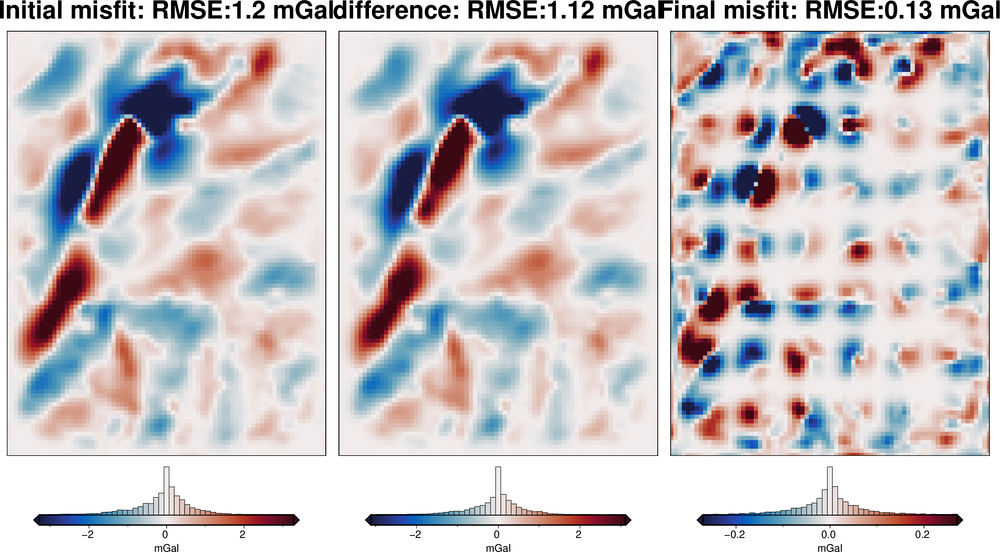

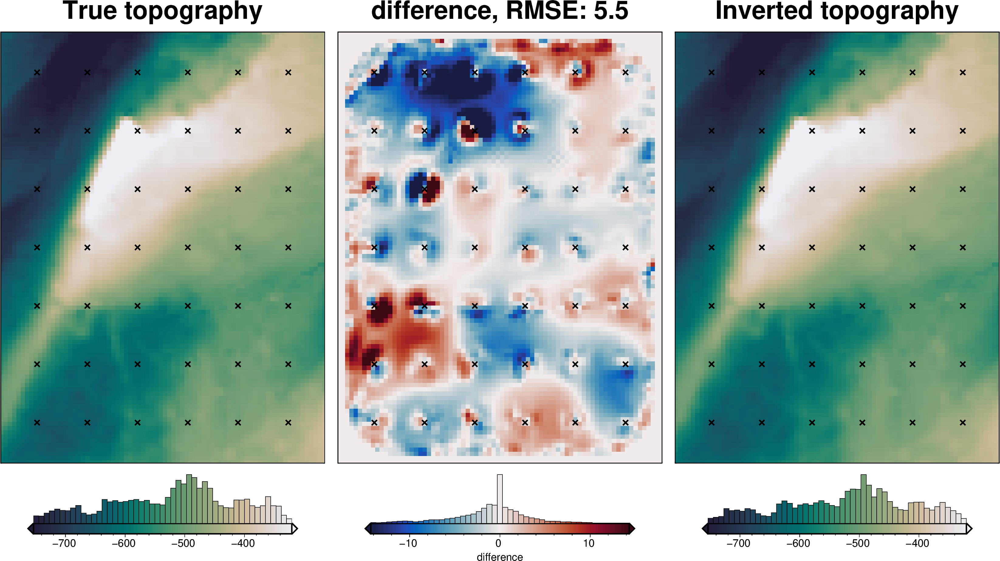

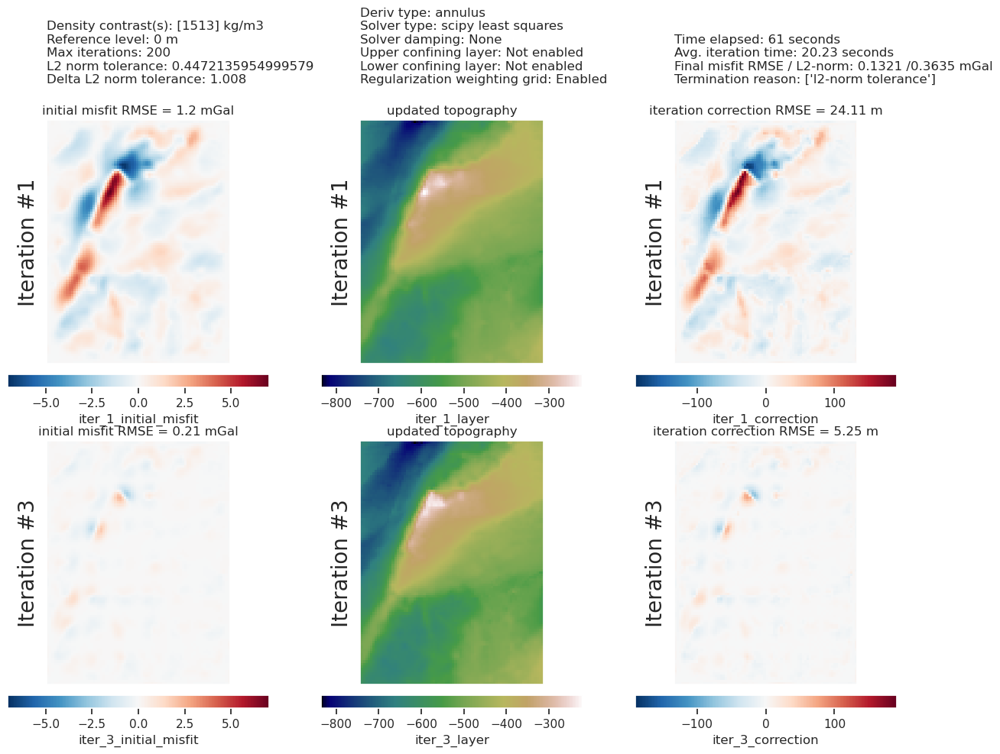

In [45]:
plotting.plot_inversion_results(
    grav_results,
    topo_results,
    parameters,
    inversion_region,
    iters_to_plot=2,
    plot_iter_results=True,
    plot_topo_results=True,
    plot_grav_results=True,
)

final_topography = topo_results.set_index(["northing", "easting"]).to_xarray().topo

_ = polar_utils.grd_compare(
    bathymetry,
    final_topography,
    region=inversion_region,
    grid1_name="True topography",
    grid2_name="Inverted topography",
    robust=True,
    hist=True,
    inset=False,
    verbose="q",
    title="difference",
    grounding_line=False,
    reverse_cpt=True,
    cmap="rain",
    points=constraint_points[constraint_points.inside],
    points_style="x.2c",
)

In [46]:
# sample the inverted topography at the constraint points
constraint_points = utils.sample_grids(
    constraint_points,
    final_topography,
    "inverted_topography",
    coord_names=("easting", "northing"),
)

rmse = utils.rmse(constraint_points.upward - constraint_points.inverted_topography)
print(f"RMSE: {rmse:.2f} m")

RMSE: 0.17 m


In [33]:
# save to csv
constraint_points.to_csv(f"{fpath}_constraint_points.csv", index=False)

# Uncertainty analysis

## Inversion error

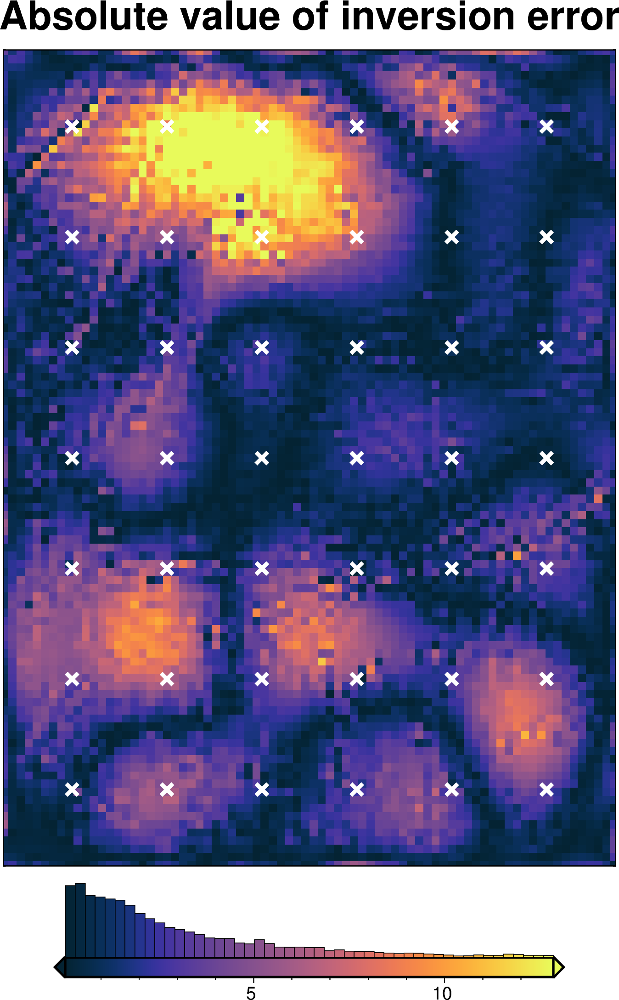

In [34]:
inversion_error = np.abs(bathymetry - final_topography)

fig = maps.plot_grd(
    inversion_error,
    region=inversion_region,
    hist=True,
    cmap="thermal",
    title="Absolute value of inversion error",
    robust=True,
    points=constraint_points[constraint_points.inside],
    points_style="x.3c",
    points_fill="white",
    points_pen="2p",
)
fig.show()

In [35]:
# re-load the study from the saved pickle file
with pathlib.Path(f"{regional_grav_kwargs.get('cv_kwargs').get('fname')}.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)
reg_eq_depth = min(study.best_trials, key=lambda t: t.values[0]).params["depth"]
reg_eq_damping = None

new_regional_grav_kwargs = dict(
    method="constraints",
    grid_method="eq_sources",
    constraints_df=constraint_points,
    damping=reg_eq_damping,
    depth=reg_eq_depth,
    block_size=None,
)
reg_eq_depth, reg_eq_damping

(312531.93345987285, None)

In [36]:
# kwargs to reuse for all uncertainty analyses
uncert_kwargs = dict(
    grav_df=grav_df,
    density_contrast=best_density_contrast,
    zref=zref,
    starting_prisms=starting_prisms,
    starting_topography=starting_bathymetry,
    regional_grav_kwargs=new_regional_grav_kwargs,
    **kwargs,
)

## Solver damping component

In [37]:
# load study
with pathlib.Path(f"{fpath}_damping_cv_damping_cv_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

study_df = study.trials_dataframe().drop(columns=["user_attrs_results"])
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

# pick damping standard deviation based on optimization
stdev = np.log10(study_df2.params_damping).std()
print(f"calculated stdev: {stdev}")
stdev = stdev / 2
print(f"using stdev: {stdev}")

calculated stdev: 0.4929588170890255
using stdev: 0.24647940854451275


best: 0.013317391250485854 
std: 0.24647940854451275 
+1std: 0.023490841122401757 
-1std: 0.0075498748126727


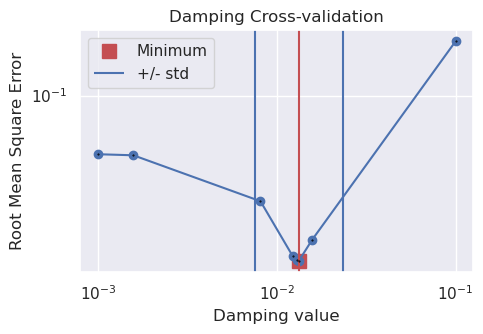

In [38]:
fig = plotting.plot_cv_scores(
    study_df.value,
    study_df.params_damping,
    param_name="Damping",
    logx=True,
    logy=True,
)
ax = fig.axes[0]

best = float(study_df2.params_damping.iloc[0])
upper = float(10 ** (np.log10(best) + stdev))
lower = float(10 ** (np.log10(best) - stdev))

y_lims = ax.get_ylim()
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.015307197532102588, min: 0.005235963494031131, max: 0.03387206765683048
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/inversion_for_poster_uncertainty_damping' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/inversion_for_poster_uncertainty_damping'



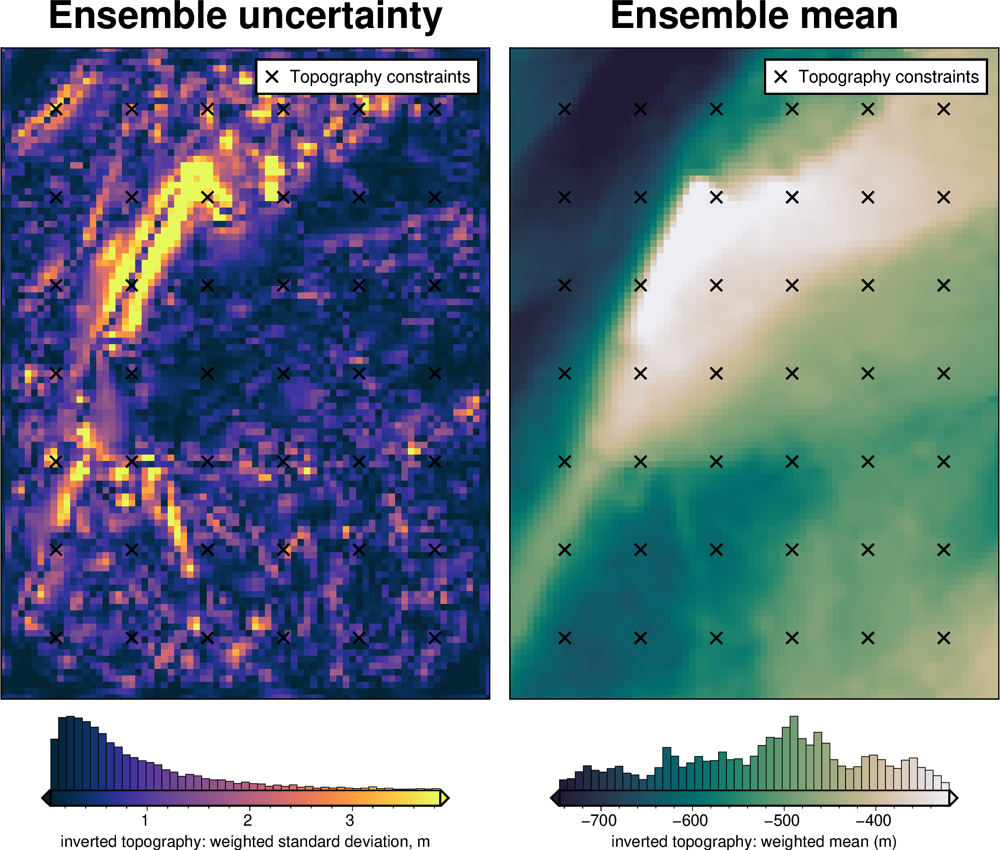

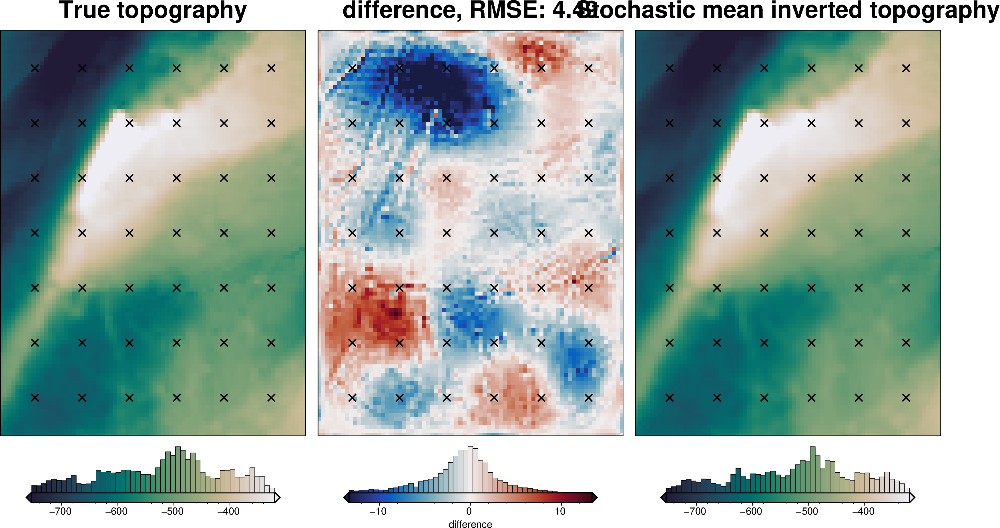

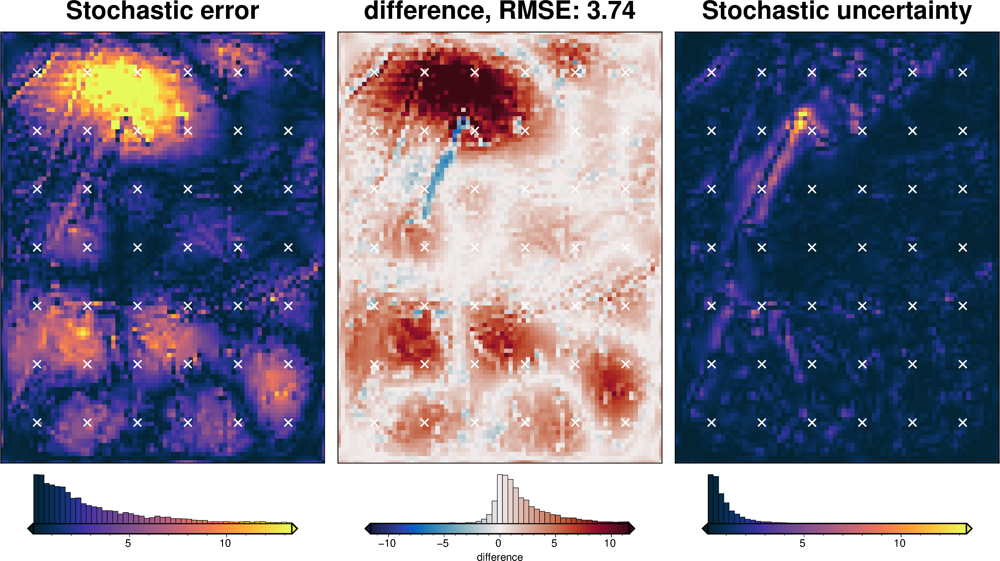

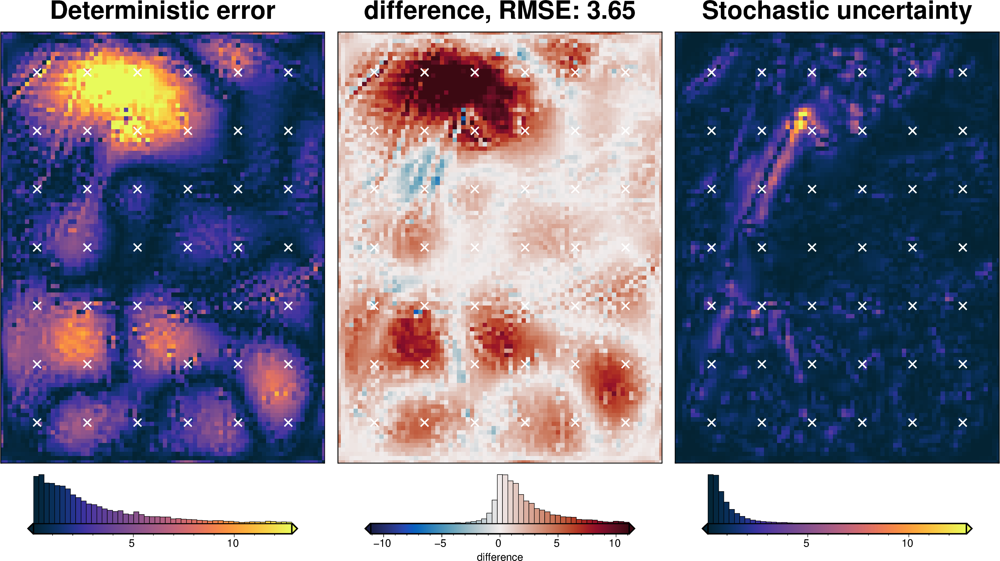

In [39]:
solver_dict = {
    "solver_damping": {
        "distribution": "normal",
        "loc": np.log10(best_damping),  # mean of base 10 exponent
        "scale": stdev,  # 0.2,  # standard deviation of base 10 exponent
        "log": True,
    },
}
fname = f"{fpath}_uncertainty_damping"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_damping_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=solver_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_damping_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
)

## Density component

In [40]:
# load study
with pathlib.Path(f"{fpath}_density_cv_kfolds_study.pickle").open(
    "rb"
) as f:
    study = pickle.load(f)

study_df = study.trials_dataframe()
study_df = study_df.sort_values("value")

# calculate zscores of values
study_df["value_zscore"] = sp.stats.zscore(study_df["value"])

# drop outliers (values with zscore > |2|)
study_df2 = study_df[(np.abs(study_df.value_zscore) < 2)]

stdev = study_df2.params_density_contrast.std()
print(f"calculated stdev: {stdev}")

# manually pick a stdev
# stdev = 100
print(f"using stdev: {stdev}")

print(
    f"density estimation error: {np.abs(true_density_contrast - best_density_contrast)}"
)

calculated stdev: 292.88511554719014
using stdev: 292.88511554719014
density estimation error: 37


best: 1612 
std: 292.88511554719014 
+1std: 1904.8851155471903 
-1std: 1319.1148844528097


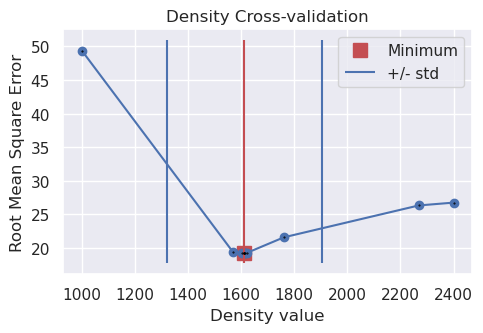

In [41]:
fig = plotting.plot_cv_scores(
    study.trials_dataframe().value.values,
    study.trials_dataframe().params_density_contrast.values,
    param_name="Density",
    logx=False,
    logy=False,
)
ax = fig.axes[0]

best = study_df2.params_density_contrast.iloc[0]
upper = best + stdev
lower = best - stdev

y_lims = ax.get_ylim()
ax.vlines(best, ymin=y_lims[0], ymax=y_lims[1], color="r")
ax.vlines(upper, ymin=y_lims[0], ymax=y_lims[1], label="+/- std")
ax.vlines(lower, ymin=y_lims[0], ymax=y_lims[1])

x_lims = ax.get_xlim()
ax.set_xlim(
    min(x_lims[0], lower),
    max(x_lims[1], upper),
)
ax.legend()
print("best:", best, "\nstd:", stdev, "\n+1std:", upper, "\n-1std:", lower)

INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 1513.0, min: 1031.246855412103, max: 1994.7531445878967
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/inversion_for_poster_uncertainty_density' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/inversion_for_poster_uncertainty_density'



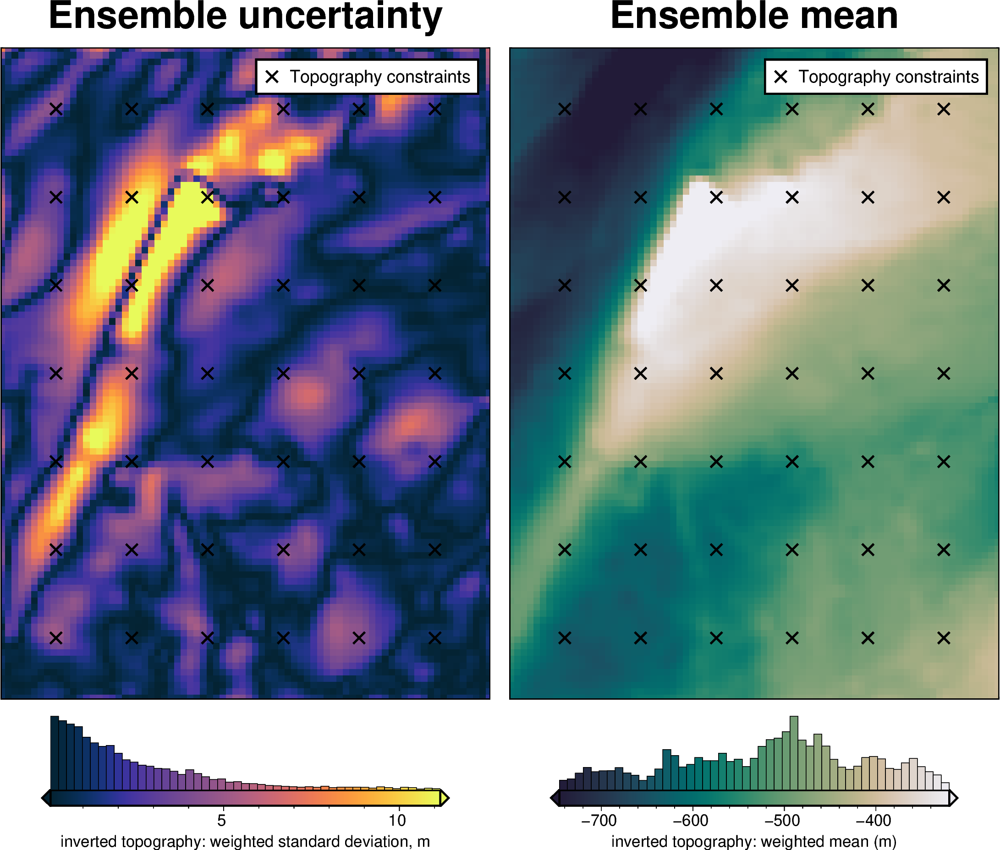

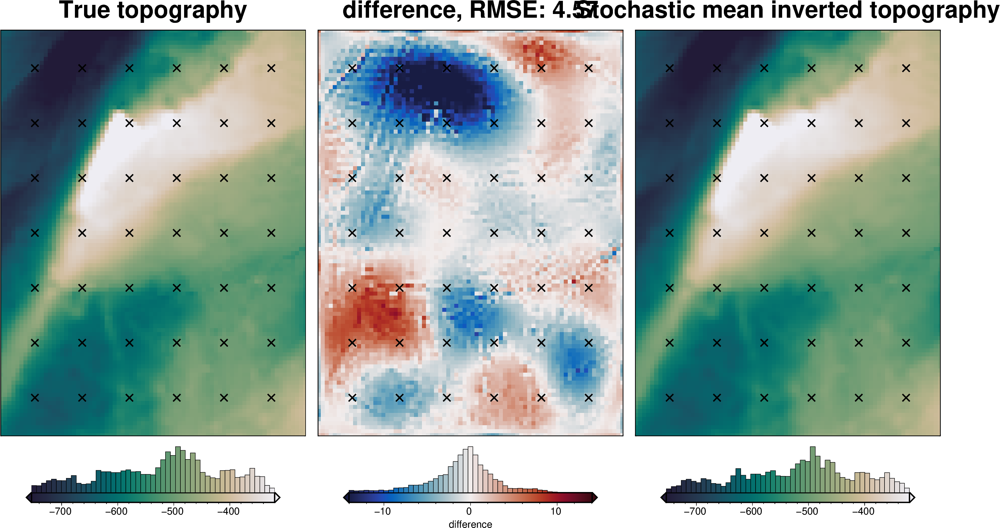

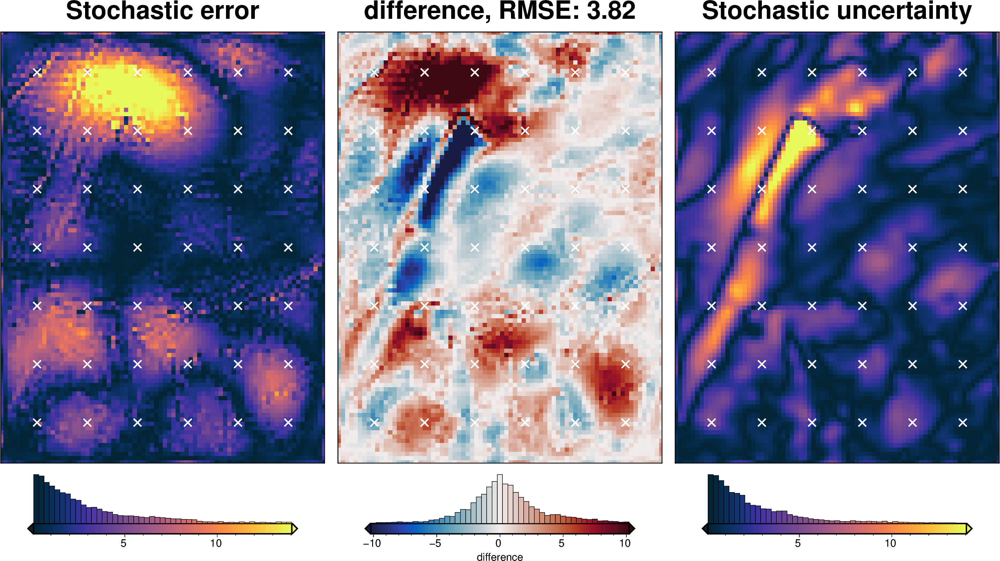

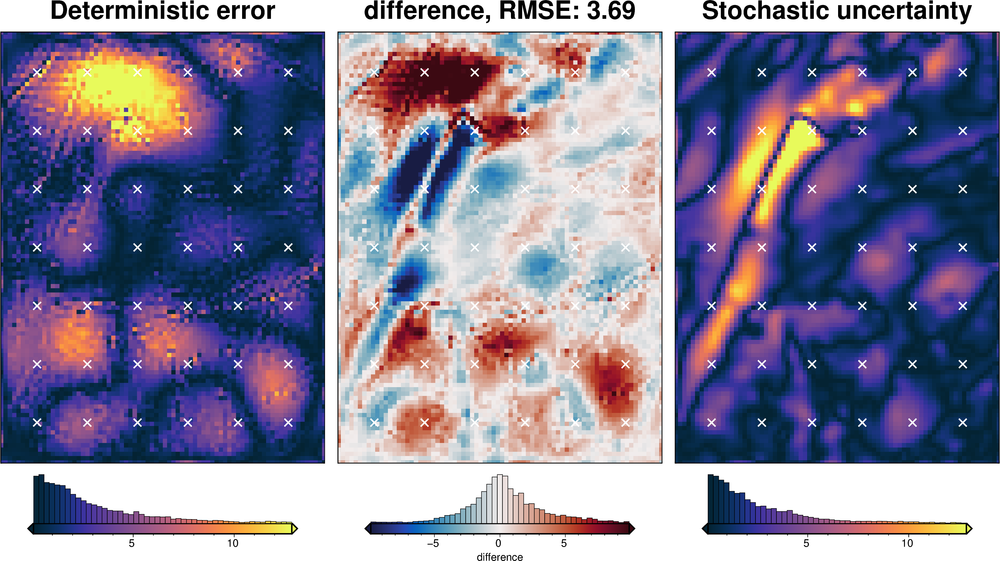

In [42]:
density_dict = {
    "density_contrast": {
        "distribution": "normal",
        "loc": best_density_contrast,
        "scale": stdev,
    },
}
fname = f"{fpath}_uncertainty_density"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_density_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=density_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_density_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points[constraint_points.inside],
    weight_by="constraints",
)

## Total uncertainty

INFO:invert4geom:Sampled 'solver_damping' parameter values; mean: 0.01530719753210259, min: 0.005235963494031131, max: 0.03387206765683048
INFO:invert4geom:Sampled 'density_contrast' parameter values; mean: 1512.9999999999998, min: 1031.246855412103, max: 1994.7531445878967
INFO:invert4geom:No pickle files starting with '../results/Ross_Sea/inversion_for_poster_uncertainty_full' found, creating new files



stochastic ensemble:   0%|          | 0/10 [00:00<?, ?it/s]

INFO:invert4geom:starting stochastic uncertainty analysis at run 0 of 10
saving results to pickle files with prefix: '../results/Ross_Sea/inversion_for_poster_uncertainty_full'



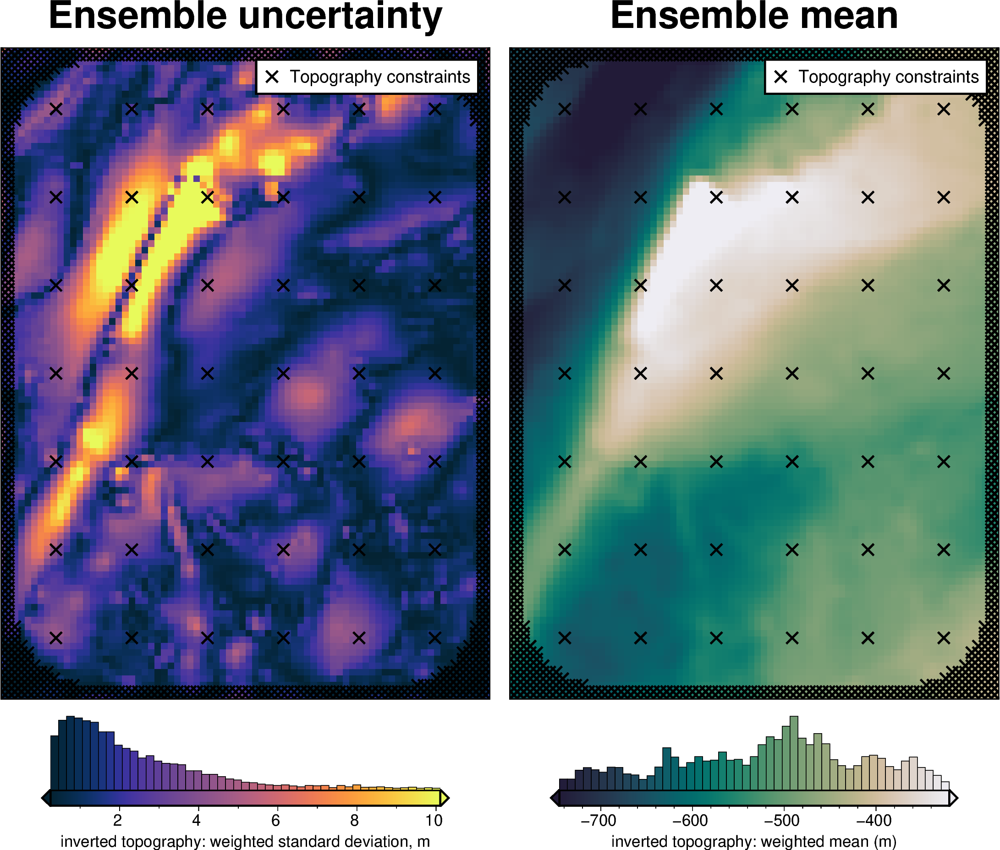

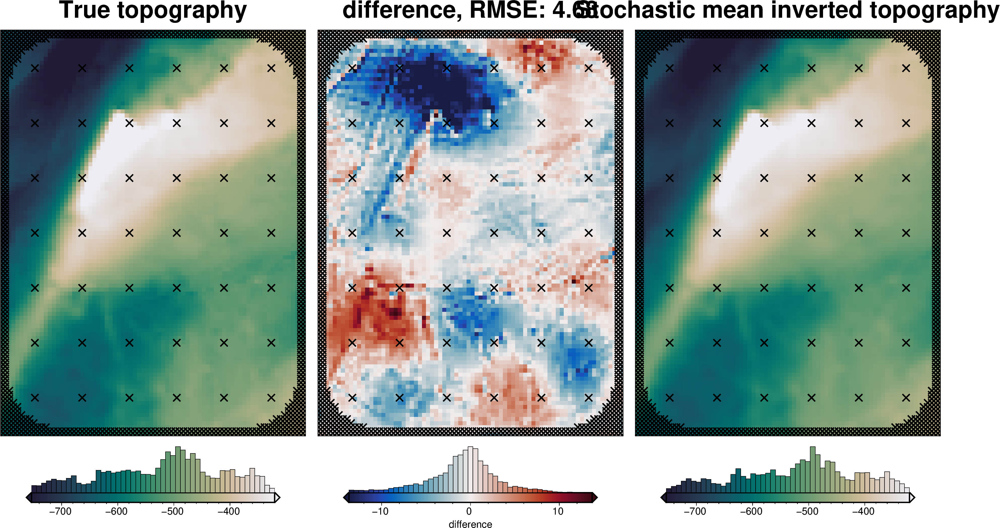

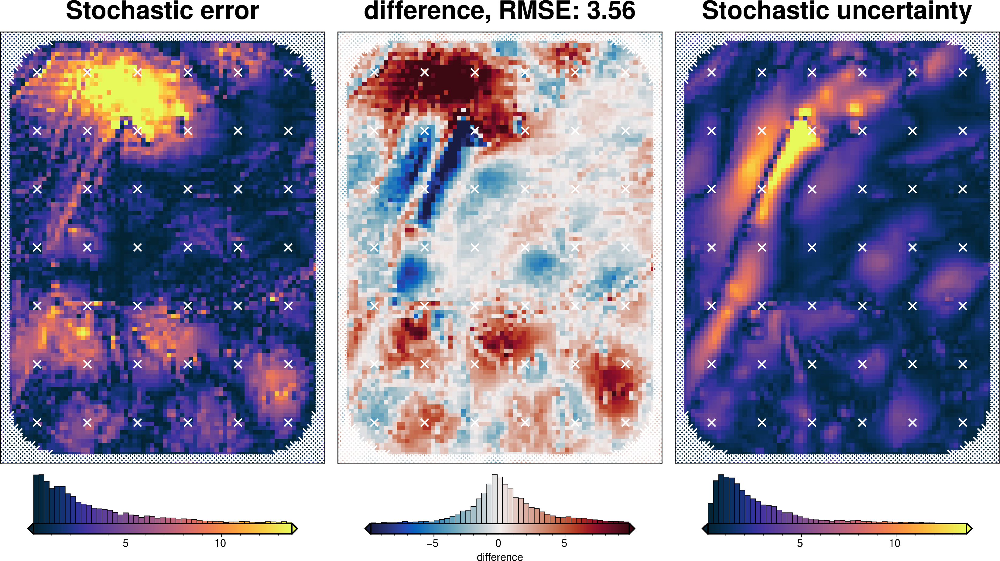

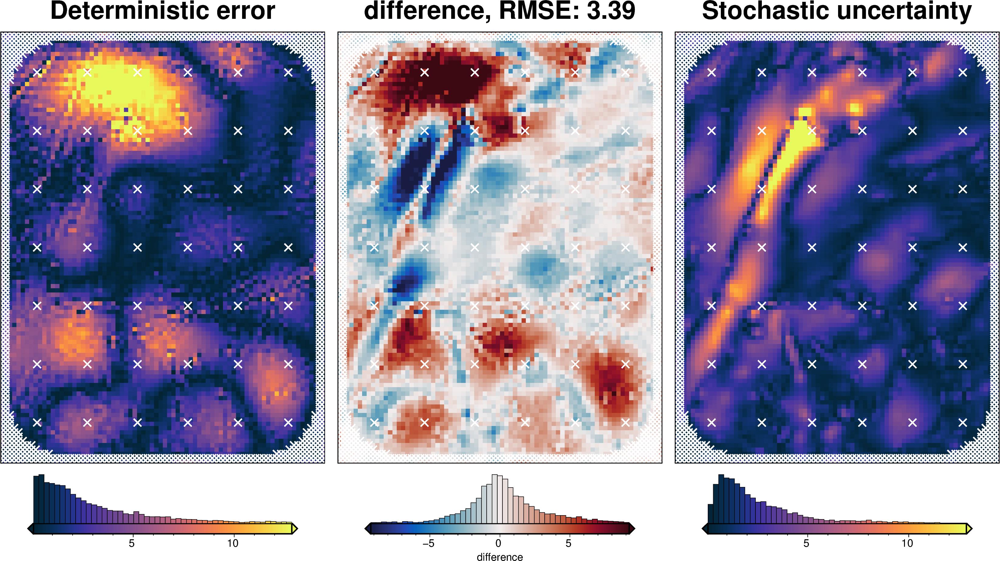

In [43]:
fname = f"{fpath}_uncertainty_full"

# delete files if already exist
for p in pathlib.Path().glob(f"{fname}*"):
    p.unlink(missing_ok=True)

uncert_results = uncertainty.full_workflow_uncertainty_loop(
    fname=fname,
    runs=10,
    parameter_dict=solver_dict | density_dict,
    **uncert_kwargs,
)

stats_ds = synth_plotting.uncert_plots(
    uncert_results,
    inversion_region,
    bathymetry,
    deterministic_bathymetry=final_topography,
    constraint_points=constraint_points,
    weight_by="constraints",
)

### Comparing results

In [44]:
results = [
    uncert_results,
    uncert_density_results,
    uncert_damping_results,
]

# get cell-wise stats for each ensemble
stats = []
for r in results:
    ds = uncertainty.merged_stats(
        results=r,
        plot=False,
        constraints_df=constraint_points,
        weight_by="constraints",
        region=inversion_region,
    )
    stats.append(ds)

In [45]:
names = [
    "full",
    "density",
    "damping",
]

# get the standard deviation of the ensemble of ensembles
stdevs = []
for i, s in enumerate(stats):
    stdevs.append(s.weighted_stdev.rename(f"{names[i]}_stdev"))

merged = xr.merge(stdevs)
merged

<xarray.Dataset> Size: 186kB
Dimensions:        (northing: 101, easting: 76)
Coordinates:
  * northing       (northing) float64 808B -1.6e+06 -1.598e+06 ... -1.4e+06
  * easting        (easting) float64 608B -4e+04 -3.8e+04 ... 1.08e+05 1.1e+05
Data variables:
    full_stdev     (northing, easting) float64 61kB 0.8503 0.6517 ... 5.709
    density_stdev  (northing, easting) float64 61kB 0.8541 0.2394 ... 6.023
    damping_stdev  (northing, easting) float64 61kB 0.4819 0.5228 ... 0.706

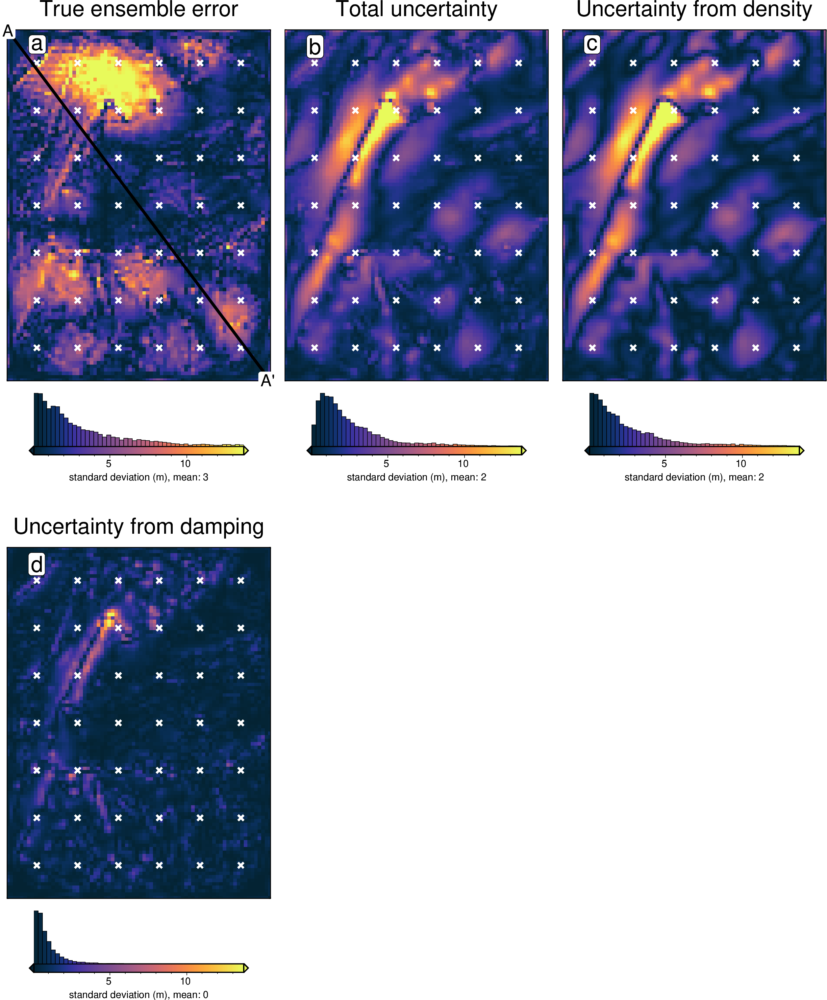

In [46]:
titles = [
    "True ensemble error",
    "Total uncertainty",
    "Uncertainty from density",
    "Uncertainty from damping",
]
grids = list(merged.data_vars.values())

grids.insert(0, np.abs(stats[0].weighted_mean - bathymetry))

cpt_lims = polar_utils.get_combined_min_max(grids, robust=True)

fig_height = 9
for i, g in enumerate(grids):
    xshift_amount = 1
    if i == 0:
        fig = None
        origin_shift = "initialize"
    elif i == 3:
        origin_shift = "both_shift"
        xshift_amount = -2
    else:
        origin_shift = "xshift"

    fig = maps.plot_grd(
        grid=g,
        fig_height=fig_height,
        title=titles[i],
        title_font="16p,Helvetica,black",
        cmap="thermal",
        cpt_lims=cpt_lims,
        robust=True,
        cbar_label=f"standard deviation (m), mean: {int(np.nanmean(g))}",
        hist=True,
        hist_bin_num=50,
        fig=fig,
        origin_shift=origin_shift,
        xshift_amount=xshift_amount,
    )
    fig.plot(
        x=constraint_points[constraint_points.inside].easting,
        y=constraint_points[constraint_points.inside].northing,
        style="x.2c",
        fill="white",
        pen="1.5p,white",
    )
    fig.text(
        position="TL",
        text=f"{string.ascii_lowercase[i]}",
        fill="white",
        pen=True,
        font="16p,Helvetica,black",
        offset="j.6/.2",
        clearance="+tO",
        no_clip=True,
    )
    if i == 0:
        # plot profiles location, and endpoints on map
        start = [inversion_region[0], inversion_region[3]]
        stop = [inversion_region[1], inversion_region[2]]
        fig.plot(
            vd.line_coordinates(start, stop, size=100),
            pen="2p,black",
        )
        fig.text(
            x=start[0],
            y=start[1],
            text="A",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
        fig.text(
            x=stop[0],
            y=stop[1],
            text="A' ",
            fill="white",
            font="12p,Helvetica,black",
            justify="CM",
            clearance="+tO",
            no_clip=True,
        )
fig.show()

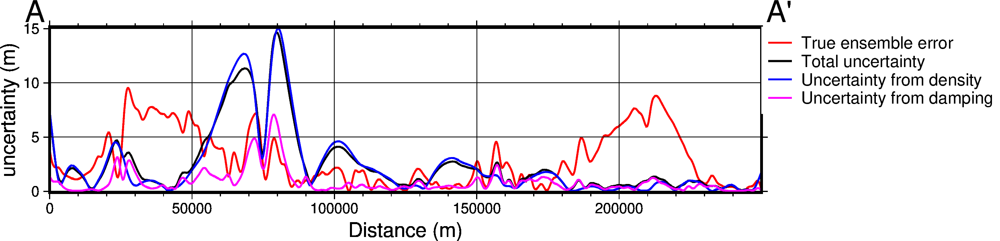

In [47]:
data_dict = profiles.make_data_dict(
    names=titles,
    grids=grids,
    colors=[
        "red",
        "black",
        "blue",
        "magenta",
        "cyan",
        "green",
        "purple",
    ],
)

fig, df_data = profiles.plot_data(
    "points",
    start=[inversion_region[0], inversion_region[3]],
    stop=[inversion_region[1], inversion_region[2]],
    num=10000,
    fig_height=4,
    fig_width=15,
    data_dict=data_dict,
    data_legend_loc="jTR+jTL",
    data_legend_box="+gwhite",
    data_buffer=0.01,
    data_frame=["neSW", "xafg+lDistance (m)", "yag+luncertainty (m)"],
    share_yaxis=True,
    start_label="A",
    end_label="A' ",
)
fig.show()

In [48]:
# save results
merged.to_netcdf(f"{fpath}_sensitivity.nc")

In [49]:
stats_ds.to_netcdf(f"{fpath}_uncertainty.nc")